# Variational AutoEconders
#### Authors:
- Izquierdo Álvarez, Mario
- Romero Romero, Martín

<div style="background-color: #ffffcc; padding: 10px;">

### **Introduction**
In this notebook, we explore the creation, training, and evaluation of various VAE models. Additionally, we provide commentary on the results obtained and an exploration of the latent space of the VAEs, generating new images and interpolations between vectors in the latent space.

</div>

In [1]:
import os
path = os.path.join('..')
os.sys.path.append(path)

### Reading data

In [2]:
DATA_FOLDER = "../archive/img_align_celeba/"

import numpy as np
import glob, os
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.layers import Input, Conv2D, Flatten, Dense, Conv2DTranspose, Reshape, Lambda, Activation, BatchNormalization, LeakyReLU, Dropout
from keras.models import Model
from keras import backend as K
from tensorflow.keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint 
from tensorflow.keras import callbacks
import fid as fid
from rich import print
import random
from tensorflow.keras.models import load_model
from keras.applications.inception_v3 import InceptionV3
from tensorflow.python.framework.ops import disable_eager_execution
from keras.applications.inception_v3 import preprocess_input

filenames = np.array(glob.glob(os.path.join(DATA_FOLDER, '*/*.jpg')))
NUM_IMAGES = len(filenames)
print("Total number of images : " + str(NUM_IMAGES))
# prints : Total number of images : 100000

INPUT_DIM = (64,64,3) # Image dimension
BATCH_SIZE = 512
Z_DIM = 200 # Dimension of the latent vector (z)


data_flow = ImageDataGenerator(rescale=1./255).flow_from_directory(DATA_FOLDER, 
    target_size = INPUT_DIM[:2],
    batch_size = BATCH_SIZE,
    shuffle = True,
    class_mode = 'input',
    subset = 'training',
    color_mode='grayscale'
    )

data_flow = ImageDataGenerator(rescale=1./255).flow_from_directory(DATA_FOLDER, 
    target_size = (INPUT_DIM[0], INPUT_DIM[1]),
    batch_size = BATCH_SIZE,
    shuffle = True,
    class_mode = 'input',
    subset = 'training',
    color_mode='rgb'
    )


2024-05-20 13:01:21.972957: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-05-20 13:01:22.000288: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-05-20 13:01:22.000313: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-05-20 13:01:22.000986: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-05-20 13:01:22.005766: I tensorflow/core/platform/cpu_feature_guar

Total number of images : 202599

Found 202599 images belonging to 1 classes.
Found 202599 images belonging to 1 classes.


### Creating the Encoder

In [3]:
#from keras.utils.vis_utils import plot_model
from tensorflow.keras.utils import plot_model
from tensorflow.keras import backend as K
# ENCODER
def build_vae_encoder(input_dim, output_dim, conv_filters, conv_kernel_size, conv_strides):
  
    # Clear tensorflow session to reset layer index numbers to 0 for LeakyRelu, 
    # BatchNormalization and Dropout.
    # Otherwise, the names of above mentioned layers in the model 
    # would be inconsistent
    global K
    K.clear_session()
    
    # Number of Conv layers
    n_layers = len(conv_filters)

    # Define model input
    encoder_input = Input(shape = input_dim, name = 'encoder_input')
    x = encoder_input

    # Add convolutional layers
    for i in range(n_layers):
        x = Conv2D(filters = conv_filters[i], 
            kernel_size = conv_kernel_size[i],
            strides = conv_strides[i], 
            padding = 'same',
            name = 'encoder_conv_' + str(i)
            )(x)

        x = LeakyReLU()(x)
        
    # Required for reshaping latent vector while building Decoder
    shape_before_flattening = K.int_shape(x)[1:] 
    
    x = Flatten()(x)
    mean_mu = Dense(output_dim, name = 'mu')(x)
    log_var = Dense(output_dim, name = 'log_var')(x)

    # Defining a function for sampling
    def sampling(args):
        mean_mu, log_var = args
        epsilon = K.random_normal(shape=K.shape(mean_mu), mean=0., stddev=1.) 
        return mean_mu + K.exp(log_var/2)*epsilon   

    # Using a Keras Lambda Layer to include the sampling function as a layer 
    # in the model
    encoder_output = Lambda(sampling, name='encoder_output')([mean_mu, log_var])


    return encoder_input, encoder_output, mean_mu, log_var, shape_before_flattening, Model(encoder_input, encoder_output)


vae_encoder_input, vae_encoder_output,  mean_mu, log_var, vae_shape_before_flattening, vae_encoder  = build_vae_encoder(
    input_dim = INPUT_DIM,
    output_dim = Z_DIM, 
    conv_filters = [32, 64, 64, 64],
    #conv_filters = [16, 32, 32, 32],
    conv_kernel_size = [3,3,3,3],
    conv_strides = [2,2,2,2])

vae_encoder.summary()

plot_model(vae_encoder, show_shapes=True, show_layer_names=True)

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 encoder_input (InputLayer)  [(None, 64, 64, 3)]          0         []                            
                                                                                                  
 encoder_conv_0 (Conv2D)     (None, 32, 32, 32)           896       ['encoder_input[0][0]']       
                                                                                                  
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 32)           0         ['encoder_conv_0[0][0]']      
                                                                                                  
 encoder_conv_1 (Conv2D)     (None, 16, 16, 64)           18496     ['leaky_re_lu[0][0]']         
                                                                                              

2024-05-20 13:01:28.695393: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-05-20 13:01:28.721969: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-05-20 13:01:28.722173: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

### Creating the Decoder

In [4]:
def build_decoder(input_dim, shape_before_flattening, conv_filters, conv_kernel_size, conv_strides):

    # Number of Conv layers
    n_layers = len(conv_filters)

    # Define model input
    decoder_input = Input(shape = (input_dim,) , name = 'decoder_input')

    # To get an exact mirror image of the encoder
    x = Dense(np.prod(shape_before_flattening))(decoder_input)
    x = Reshape(shape_before_flattening)(x)

    # Add convolutional layers
    for i in range(n_layers):
        x = Conv2DTranspose(
            filters = conv_filters[i], 
            kernel_size = conv_kernel_size[i],
            strides = conv_strides[i], 
            padding = 'same',
            name = 'decoder_conv_' + str(i)
            )(x)
        
        # Adding a sigmoid layer at the end to restrict the outputs 
        # between 0 and 1
        if i < n_layers - 1:
            x = LeakyReLU()(x)
        else:
            x = Activation('sigmoid')(x)

    # Define model output
    decoder_output = x

    return decoder_input, decoder_output, Model(decoder_input, decoder_output)

decoder_input, decoder_output, vae_decoder = build_decoder(input_dim = Z_DIM,
    shape_before_flattening = vae_shape_before_flattening,
    conv_filters = [64,64,32,3],        
    #conv_filters = [32,32,16,1],
    conv_kernel_size = [3,3,3,3],
    conv_strides = [2,2,2,2]
    )

vae_decoder.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 decoder_input (InputLayer)  [(None, 200)]             0         
                                                                 
 dense (Dense)               (None, 1024)              205824    
                                                                 
 reshape (Reshape)           (None, 4, 4, 64)          0         
                                                                 
 decoder_conv_0 (Conv2DTran  (None, 8, 8, 64)          36928     
 spose)                                                          
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 8, 8, 64)          0         
                                                                 
 decoder_conv_1 (Conv2DTran  (None, 16, 16, 64)        36928     
 spose)                                                    

### Encoder + Decoder

In [5]:
vae_input = vae_encoder_input
vae_output = vae_decoder(vae_encoder_output)

# Input to the combined model will be the input to the encoder.
# Output of the combined model will be the output of the decoder.
vae = Model(vae_input, vae_output)

vae.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 encoder_input (InputLayer)  [(None, 64, 64, 3)]          0         []                            
                                                                                                  
 encoder_conv_0 (Conv2D)     (None, 32, 32, 32)           896       ['encoder_input[0][0]']       
                                                                                                  
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 32)           0         ['encoder_conv_0[0][0]']      
                                                                                                  
 encoder_conv_1 (Conv2D)     (None, 16, 16, 64)           18496     ['leaky_re_lu[0][0]']         
                                                                                            

### Reconstructing images

In [6]:
import matplotlib.pyplot as plt

def plot_compare_VAE(images, add_noise=False):
    
    n_to_show = images.shape[0]

    if add_noise:
        encodings = VAE_encoder.predict(images)
        encodings += np.random.normal(0.0, 1.0, size = (n_to_show,200))
        reconst_images = VAE_decoder.predict(encodings)

    else:
        reconst_images = vae.predict(images)


    fig = plt.figure(figsize=(12, 3))
    fig.subplots_adjust(left=0.05, bottom=0.05, right=0.95, top=0.95, hspace=0.1, wspace=0.1)

    for i in range(n_to_show):
        #img = images[i].squeeze()
        img = images[i]
        sub = fig.add_subplot(2, n_to_show, i+1)
        sub.axis('off')        
        sub.imshow(img,cmap='gray')

    for i in range(n_to_show):
        img = reconst_images[i].squeeze()
        sub = fig.add_subplot(2, n_to_show, i+n_to_show+1)
        sub.axis('off')
        sub.imshow(img,cmap='gray')
    plt.show()

class PlotCompareVAE(callbacks.Callback):
    def __init__(self, images):
        self.images=images

    def on_epoch_end(self, epoch, logs=None):

        reconst_images = self.model(self.images)
        reconst_images = reconst_images.numpy()
        n_to_show = self.images.shape[0]
        
        fig = plt.figure(figsize=(12, 3))
        fig.subplots_adjust(left=0.05, bottom=0.05, right=0.95, top=0.95, hspace=0.1, wspace=0.1)

        for i in range(n_to_show):
            #img = images[i].squeeze()
            img = self.images[i]
            sub = fig.add_subplot(2, n_to_show, i+1)
            sub.axis('off')        
            sub.imshow(img,cmap='gray')
    
        for i in range(n_to_show):
            img = reconst_images[i].squeeze()
            sub = fig.add_subplot(2, n_to_show, i+n_to_show+1)
            sub.axis('off')
            sub.imshow(img,cmap='gray')
        plt.show()
        
        
            
    

### Callback to calculate the FID metric

In [7]:
class FIDCallback(callbacks.Callback):
    def __init__(self, real_images):
        self.real_images = real_images
        self.inception_model = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))

    def on_epoch_end(self, epoch, logs=None):
        generated_images = self.model(self.real_images)

        generated_images = generated_images.numpy()
        # Resize images
        real_images_resized = fid.scale_images(self.real_images, (299, 299, 3))
        generated_images_resized = fid.scale_images(generated_images, (299, 299, 3))

        # Preprocess images
        real_images_resized = preprocess_input(real_images_resized)
        generated_images_resized = preprocess_input(generated_images_resized)

        # Calculate FID
        fid_score = fid.calculate_fid(self.inception_model, real_images_resized, generated_images_resized)
        
        # Log FID
        print(f'[bold magenta]FID at epoch {epoch + 1}:[/bold magenta] {fid_score}')
        if logs is not None:
            logs['fid'] = fid_score
            

### Callback to save the metrics

In [8]:
class LossHistory(callbacks.Callback):
    def on_train_begin(self, logs=None):
        self.history = {
            'kl_divergence': [],
            'loss': [],
            'mean_squared_error': [],
            'fid': []
        }

    def on_epoch_end(self, epoch, logs=None):
        self.history['kl_divergence'].append(logs['kl_divergence'])
        self.history['loss'].append(logs['loss'])
        self.history['mean_squared_error'].append(logs['mean_squared_error'])
        self.history['fid'].append(logs['fid'])

loss_history = LossHistory()

### Compile and train

In [9]:
import tensorflow as tf
from keras.layers import Layer
from keras.losses import mean_squared_error
#tf.config.run_functions_eagerly(True)

LEARNING_RATE = 0.0005
N_EPOCHS = 2  # No. of epochs to show advance
N_BLOCKS = 10
LOSS_FACTOR = 10000

adam_optimizer = Adam(learning_rate = LEARNING_RATE)

# Combinar las dos pérdidas
def total_losses(y_true, y_pred):
    return LOSS_FACTOR* mean_squared_error(y_true, y_pred)+tf.keras.losses.kullback_leibler_divergence(y_true, y_pred)
    
# Compile VAE model using the custom loss function
vae.compile(optimizer=adam_optimizer, loss = total_losses , metrics=[mean_squared_error, tf.keras.losses.kullback_leibler_divergence])
#vae.compile(optimizer=adam_optimizer, loss=total_loss(mean_mu, log_var), metrics=[r_loss, kl_loss])



example_batch = next(data_flow)
example_batch = example_batch[0]
example_images = example_batch[:8]
x=(NUM_IMAGES / BATCH_SIZE)
FID_metric = FIDCallback(real_images=example_images)
plot_compare= PlotCompareVAE(images=example_images)
#fid_calculator = FIDCalculator(vae_decoder, example_batch[0], Z_DIM)
#@tf.function
N_BLOCKS=1
N_EPOCHS=20
def train_model():
    for i in range(N_BLOCKS):
        vae.fit(data_flow, 
            shuffle=True, 
            epochs = N_EPOCHS, 
            initial_epoch = 0, 
            steps_per_epoch=395,
            callbacks=[FID_metric, loss_history, plot_compare])
        plot_compare_VAE(example_images) 
        


#### Mid-complex-VAE

Epoch 1/20


2024-05-20 13:01:32.395511: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8904
2024-05-20 13:01:35.258642: I external/local_xla/xla/service/service.cc:168] XLA service 0x7e74b6611880 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-05-20 13:01:35.258661: I external/local_xla/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce GTX 1650 with Max-Q Design, Compute Capability 7.5
2024-05-20 13:01:35.261988: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1716202895.313928   12290 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


1/1 [==============================] - 0s 20ms/step


FID at epoch 1: 5.49474357033977

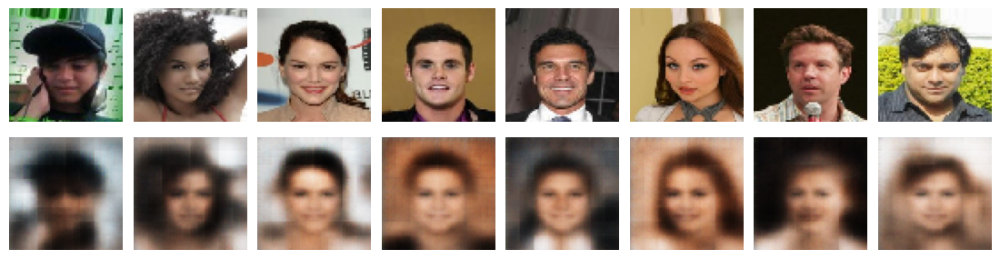

395/395 [==============================] - 81s 191ms/step - loss: 289.6025 - mean_squared_error: 0.0289 - kl_divergence: 0.1152 - fid: 5.4947
Epoch 2/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 2: 5.344069742484512

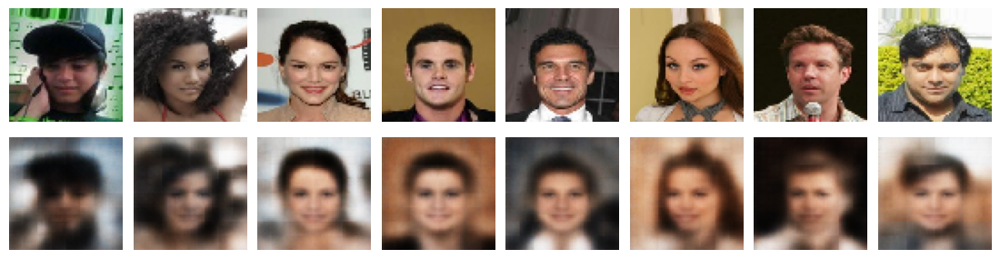

395/395 [==============================] - 75s 189ms/step - loss: 140.0314 - mean_squared_error: 0.0140 - kl_divergence: 0.0658 - fid: 5.3441
Epoch 3/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 3: 5.102493111764528

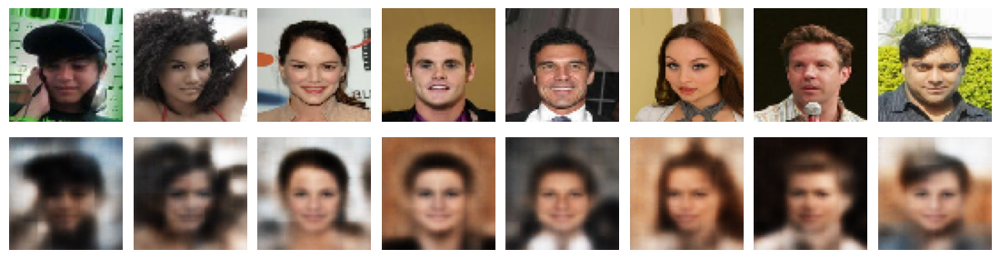

395/395 [==============================] - 69s 173ms/step - loss: 117.4400 - mean_squared_error: 0.0117 - kl_divergence: 0.0561 - fid: 5.1025
Epoch 4/20
1/1 [==============================] - 0s 25ms/step


FID at epoch 4: 4.9958537509810705

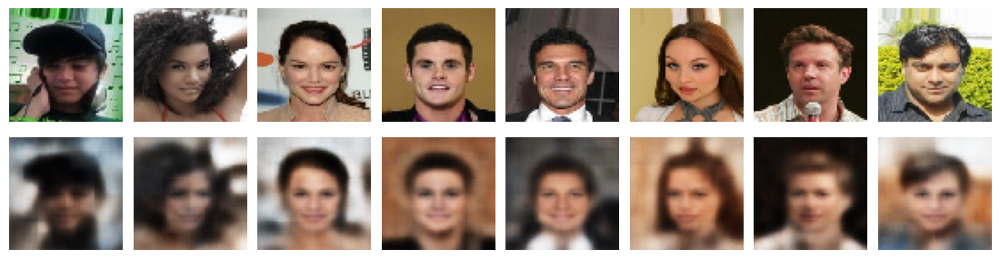

395/395 [==============================] - 71s 180ms/step - loss: 106.9834 - mean_squared_error: 0.0107 - kl_divergence: 0.0513 - fid: 4.9959
Epoch 5/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 5: 4.783721482540804

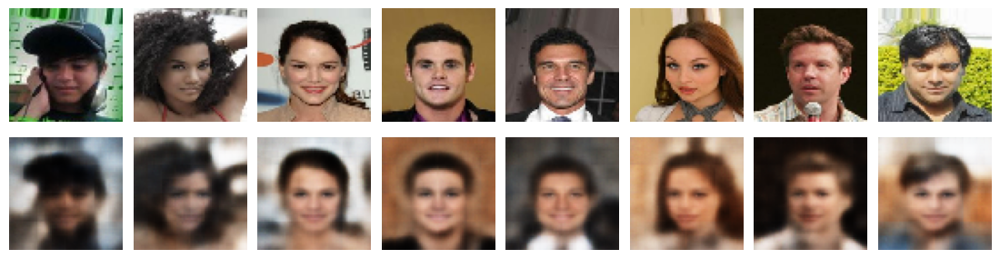

395/395 [==============================] - 69s 174ms/step - loss: 100.6742 - mean_squared_error: 0.0101 - kl_divergence: 0.0483 - fid: 4.7837
Epoch 6/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 6: 4.547940395163895

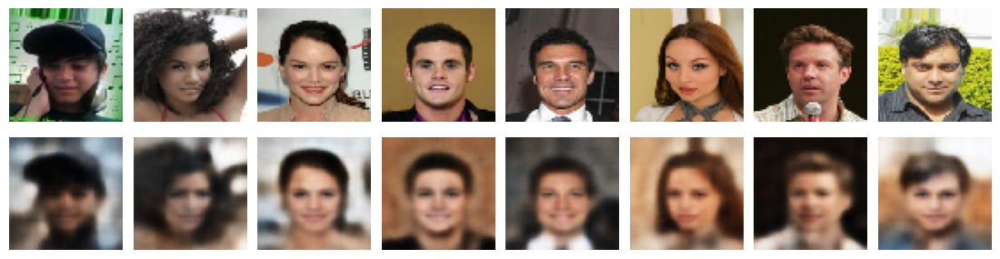

395/395 [==============================] - 71s 180ms/step - loss: 95.8833 - mean_squared_error: 0.0096 - kl_divergence: 0.0461 - fid: 4.5479
Epoch 7/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 7: 4.440048311470932

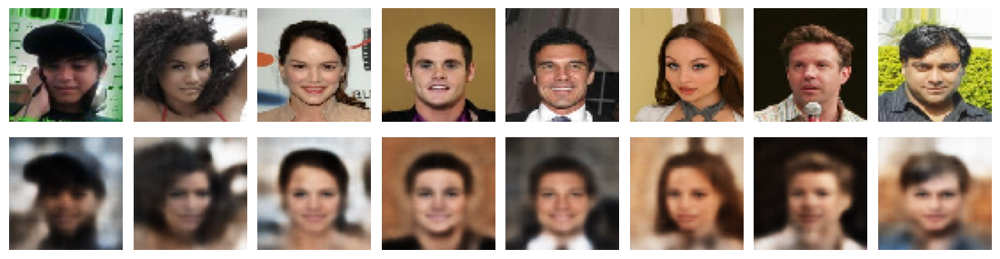

395/395 [==============================] - 67s 169ms/step - loss: 91.7810 - mean_squared_error: 0.0092 - kl_divergence: 0.0441 - fid: 4.4400
Epoch 8/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 8: 4.29320432491838

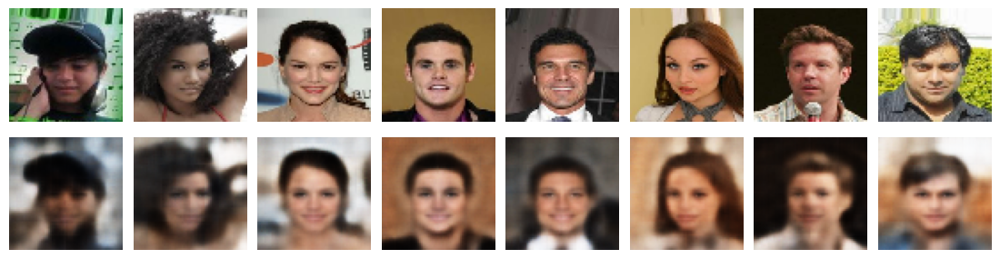

395/395 [==============================] - 70s 176ms/step - loss: 88.4470 - mean_squared_error: 0.0088 - kl_divergence: 0.0426 - fid: 4.2932
Epoch 9/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 9: 4.159763000778966

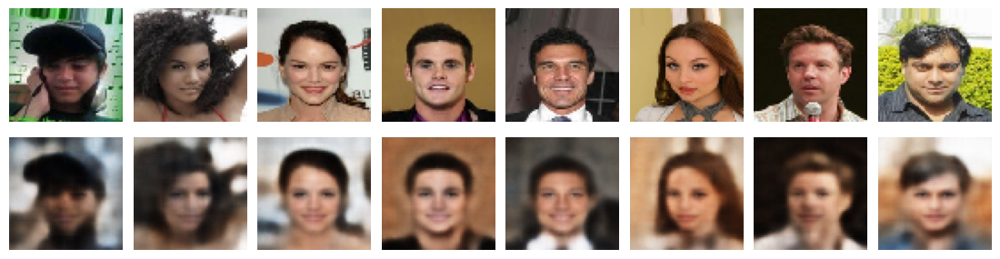

395/395 [==============================] - 69s 174ms/step - loss: 85.7291 - mean_squared_error: 0.0086 - kl_divergence: 0.0414 - fid: 4.1598
Epoch 10/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 10: 4.140501536231196

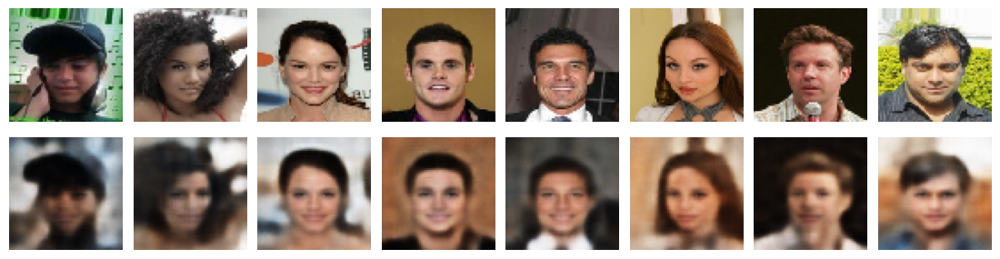

395/395 [==============================] - 70s 177ms/step - loss: 83.6447 - mean_squared_error: 0.0084 - kl_divergence: 0.0403 - fid: 4.1405
Epoch 11/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 11: 3.9879383636274515

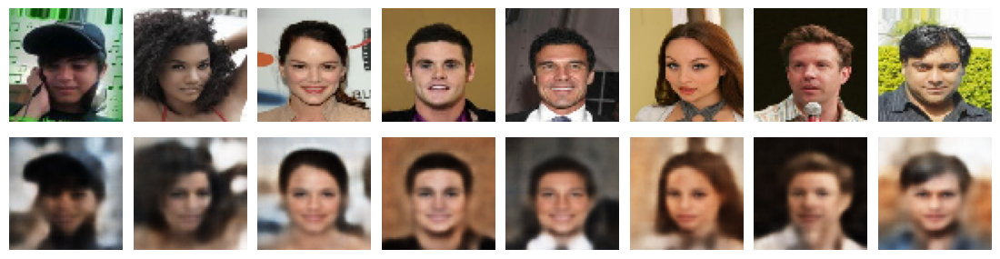

395/395 [==============================] - 69s 174ms/step - loss: 81.8069 - mean_squared_error: 0.0082 - kl_divergence: 0.0396 - fid: 3.9879
Epoch 12/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 12: 3.840696477089935

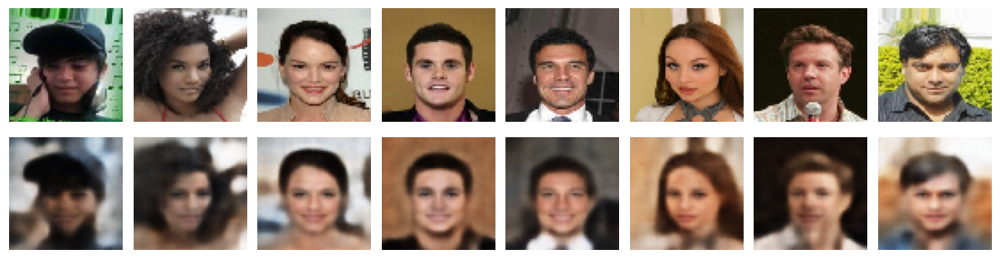

395/395 [==============================] - 72s 181ms/step - loss: 80.2914 - mean_squared_error: 0.0080 - kl_divergence: 0.0388 - fid: 3.8407
Epoch 13/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 13: 3.798338931751969

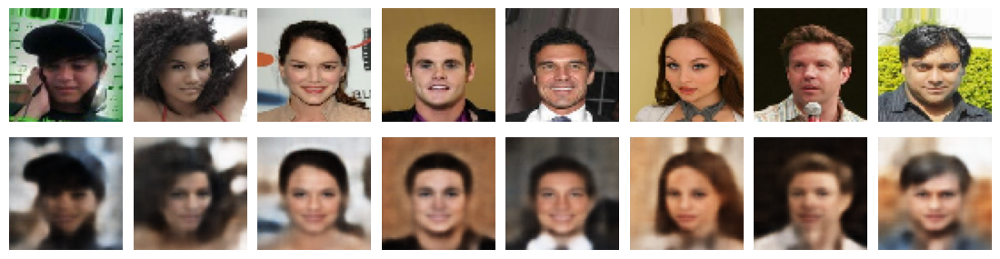

395/395 [==============================] - 73s 184ms/step - loss: 78.9361 - mean_squared_error: 0.0079 - kl_divergence: 0.0382 - fid: 3.7983
Epoch 14/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 14: 3.720616498227922

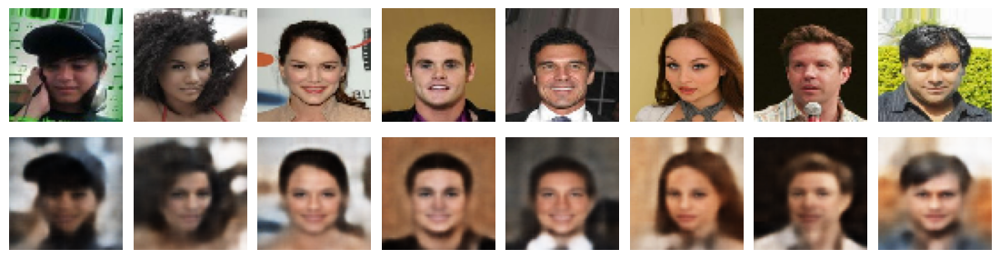

395/395 [==============================] - 72s 181ms/step - loss: 77.6671 - mean_squared_error: 0.0078 - kl_divergence: 0.0377 - fid: 3.7206
Epoch 15/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 15: 3.6286405394469226

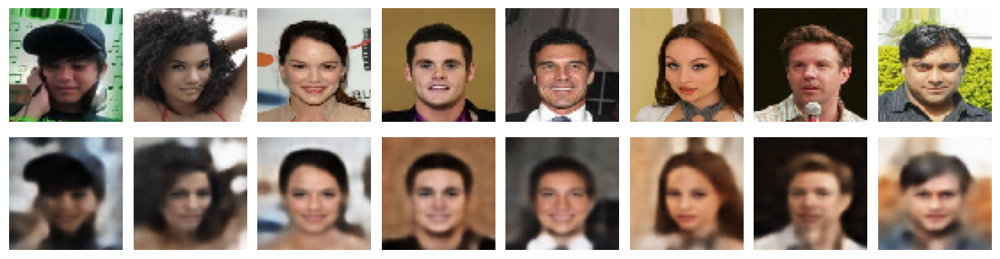

395/395 [==============================] - 68s 172ms/step - loss: 76.6064 - mean_squared_error: 0.0077 - kl_divergence: 0.0372 - fid: 3.6286
Epoch 16/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 16: 3.5799693236797885

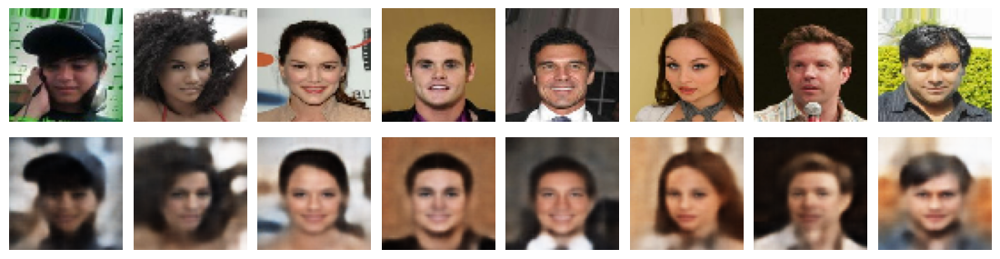

395/395 [==============================] - 71s 179ms/step - loss: 75.6319 - mean_squared_error: 0.0076 - kl_divergence: 0.0368 - fid: 3.5800
Epoch 17/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 17: 3.5162906892163064

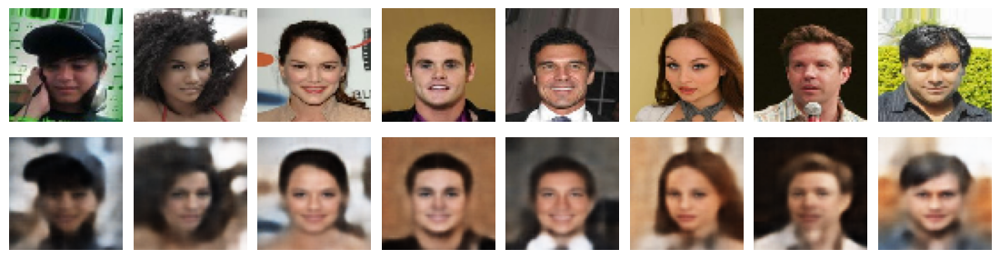

395/395 [==============================] - 69s 174ms/step - loss: 74.8209 - mean_squared_error: 0.0075 - kl_divergence: 0.0364 - fid: 3.5163
Epoch 18/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 18: 3.519576325423936

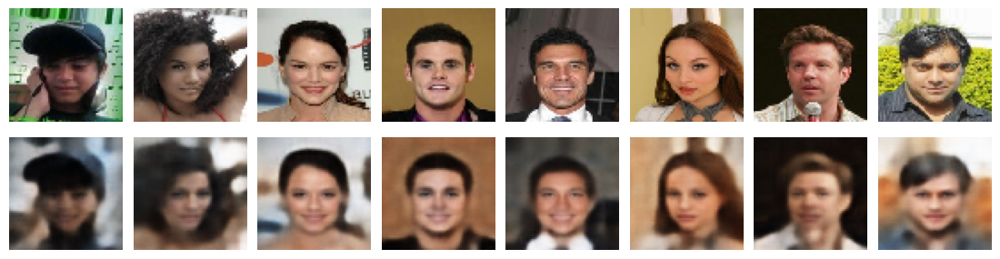

395/395 [==============================] - 68s 170ms/step - loss: 74.0678 - mean_squared_error: 0.0074 - kl_divergence: 0.0360 - fid: 3.5196
Epoch 19/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 19: 3.5085897037840756

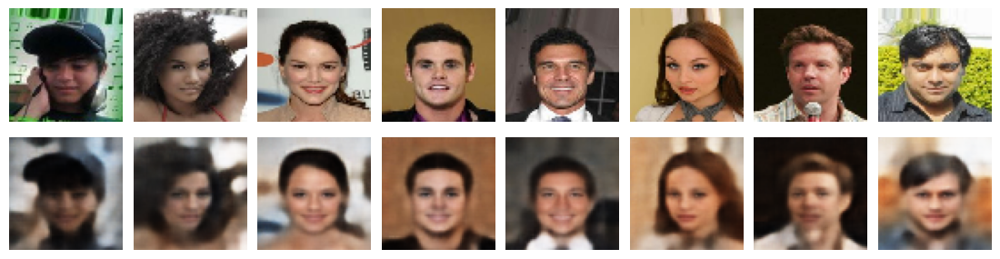

395/395 [==============================] - 67s 170ms/step - loss: 73.4095 - mean_squared_error: 0.0073 - kl_divergence: 0.0357 - fid: 3.5086
Epoch 20/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 20: 3.4059346401757358

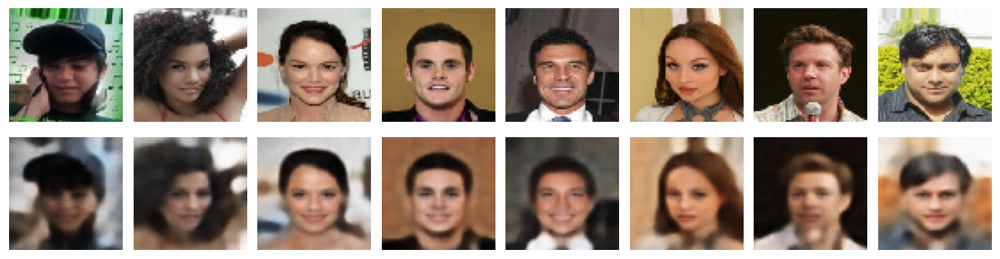

1/1 [==============================] - 0s 106ms/step


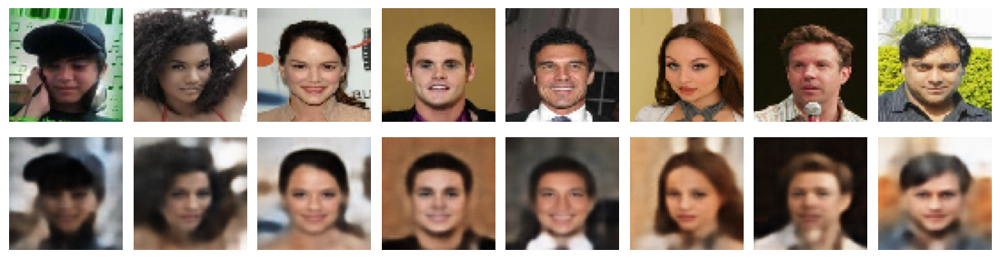

In [10]:
train_model()

### Plotting results function

In [11]:
import matplotlib.pyplot as plt

def plot_losses_and_accuracy(loss_history):
    epochs = len(loss_history.history['kl_divergence'])
    x = range(epochs)

    fig, axs = plt.subplots(2, 2, figsize=(14, 10))
    
    axs[0, 0].plot(x, loss_history.history['kl_divergence'], "o-", label="KL divergence", color="coral", alpha=0.7)
    axs[0, 0].set(xlabel="Epochs", ylabel="Divergence")
    axs[0, 0].legend()
    
    axs[0, 1].plot(x, loss_history.history['loss'], "o-",label="Loss", color="brown", alpha=0.7)
    axs[0, 1].set(xlabel="Epochs", ylabel="Loss")
    axs[0, 1].legend()
    
    axs[1, 0].plot(x, loss_history.history['mean_squared_error'], "o-",label="MSE" , color="forestgreen", alpha=0.7)
    axs[1, 0].set(xlabel="Epochs", ylabel="MSE")
    axs[1, 0].legend()
    
    axs[1, 1].plot(x, loss_history.history['fid'], "o-",label="FID", color="seagreen", alpha=0.7)
    axs[1, 1].set(xlabel="Epochs", ylabel="FID")
    axs[1, 1].legend()

    plt.show()

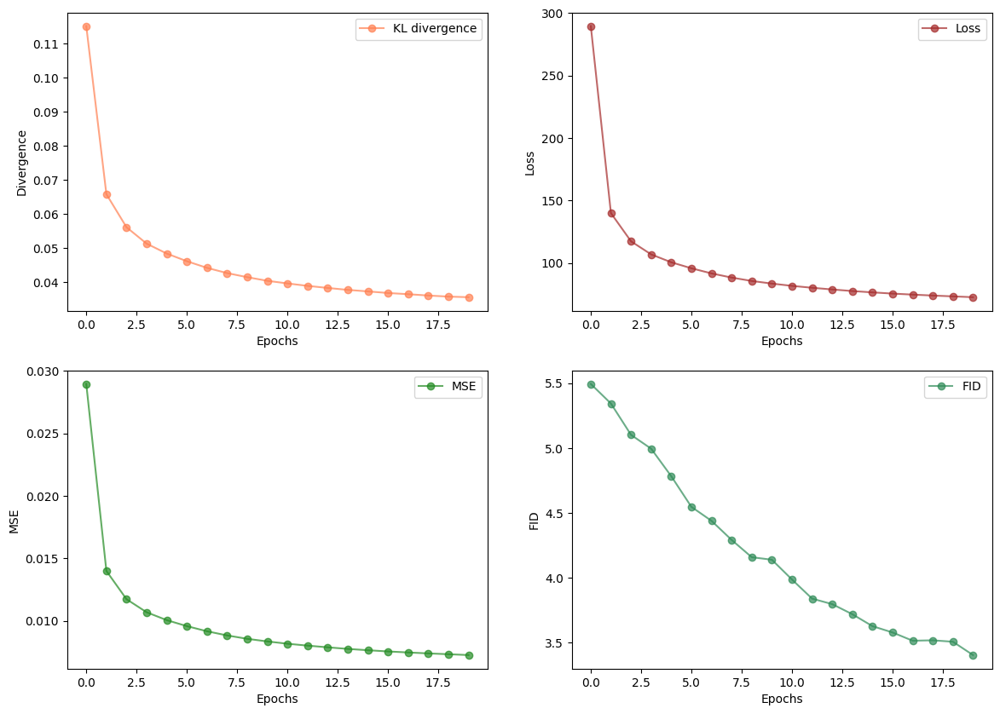

In [12]:
plot_losses_and_accuracy(loss_history)

<div style="background-color: #ffffcc; padding: 10px;">

### **Results Discussion**

After training the VAE model for 20 epochs, we see that the results obtained are quite good. The FID value obtained is 3.405, a rather low value and better than what would be expected initially. If we look at the graphs we also see that the whole training is quite stable, which is a very positive aspect. As a weak point of this training we can highlight the few training epochs, since as we can see in the graphs, the model seems that it can be improved by increasing the number of epochs (this has not been done for computational reasons, in order to reduce the training time). In the next model we will try to increase the complexity to see if we improve the results.

</div>

# Other architecture

In [13]:
## Deleting variables to avoid to crash the kernel
del vae, vae_encoder, vae_encoder_output, vae_encoder_input, vae_shape_before_flattening
del decoder_input, decoder_output, vae_decoder
del loss_history, FID_metric, plot_compare

## Build Encoder

In [14]:
vae_encoder_input, vae_encoder_output,  mean_mu, log_var, vae_shape_before_flattening, vae_encoder  = build_vae_encoder(
    input_dim = INPUT_DIM,
    output_dim = Z_DIM, 
    conv_filters = [32, 32, 64, 64, 64, 64],
    #conv_filters = [16, 32, 32, 32],
    conv_kernel_size = [3,3,3,3,3,3],
    conv_strides = [2,2,2,2,2,2])

vae_encoder.summary()

plot_model(vae_encoder, show_shapes=True, show_layer_names=True)

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 encoder_input (InputLayer)  [(None, 64, 64, 3)]          0         []                            
                                                                                                  
 encoder_conv_0 (Conv2D)     (None, 32, 32, 32)           896       ['encoder_input[0][0]']       
                                                                                                  
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 32)           0         ['encoder_conv_0[0][0]']      
                                                                                                  
 encoder_conv_1 (Conv2D)     (None, 16, 16, 32)           9248      ['leaky_re_lu[0][0]']         
                                                                                              

## Build Decoder

In [15]:
decoder_input, decoder_output, vae_decoder = build_decoder(input_dim = Z_DIM,
    shape_before_flattening = vae_shape_before_flattening,
    conv_filters = [64,64,64,32,32,3],        
    #conv_filters = [32,32,16,3],
    conv_kernel_size = [3,3,3,3,3,3],
    conv_strides = [2,2,2,2,2,2]
    )

vae_decoder.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 decoder_input (InputLayer)  [(None, 200)]             0         
                                                                 
 dense (Dense)               (None, 64)                12864     
                                                                 
 reshape (Reshape)           (None, 1, 1, 64)          0         
                                                                 
 decoder_conv_0 (Conv2DTran  (None, 2, 2, 64)          36928     
 spose)                                                          
                                                                 
 leaky_re_lu_6 (LeakyReLU)   (None, 2, 2, 64)          0         
                                                                 
 decoder_conv_1 (Conv2DTran  (None, 4, 4, 64)          36928     
 spose)                                                    

## Encoder + Decoder

In [16]:
vae_input = vae_encoder_input
vae_output = vae_decoder(vae_encoder_output)

# Input to the combined model will be the input to the encoder.
# Output of the combined model will be the output of the decoder.
vae = Model(vae_input, vae_output)

vae.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 encoder_input (InputLayer)  [(None, 64, 64, 3)]          0         []                            
                                                                                                  
 encoder_conv_0 (Conv2D)     (None, 32, 32, 32)           896       ['encoder_input[0][0]']       
                                                                                                  
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 32)           0         ['encoder_conv_0[0][0]']      
                                                                                                  
 encoder_conv_1 (Conv2D)     (None, 16, 16, 32)           9248      ['leaky_re_lu[0][0]']         
                                                                                            

## Compile and train

In [17]:
import tensorflow as tf
from keras.layers import Layer
from keras.losses import mean_squared_error
#tf.config.run_functions_eagerly(True)

LEARNING_RATE = 0.0005
N_EPOCHS = 2  # No. of epochs to show advance
N_BLOCKS = 10
LOSS_FACTOR = 10000

adam_optimizer = Adam(learning_rate = LEARNING_RATE)

# Combinar las dos pérdidas
def total_losses(y_true, y_pred):
    return LOSS_FACTOR* mean_squared_error(y_true, y_pred)+tf.keras.losses.kullback_leibler_divergence(y_true, y_pred)
    
# Compile VAE model using the custom loss function
vae.compile(optimizer=adam_optimizer, loss = total_losses , metrics=[mean_squared_error, tf.keras.losses.kullback_leibler_divergence])
#vae.compile(optimizer=adam_optimizer, loss=total_loss(mean_mu, log_var), metrics=[r_loss, kl_loss])

loss_history = LossHistory()

example_batch = next(data_flow)
example_batch = example_batch[0]
example_images = example_batch[:8]
x=(NUM_IMAGES / BATCH_SIZE)
FID_metric = FIDCallback(real_images=example_images)
plot_compare= PlotCompareVAE(images=example_images)
#fid_calculator = FIDCalculator(vae_decoder, example_batch[0], Z_DIM)
#@tf.function
N_BLOCKS=1
N_EPOCHS=20
def train_model():
    for i in range(N_BLOCKS):
        vae.fit(data_flow, 
            shuffle=True, 
            epochs = N_EPOCHS, 
            initial_epoch = 0, 
            steps_per_epoch=395,
            callbacks=[FID_metric, loss_history, plot_compare])
        plot_compare_VAE(example_images) 
        


#### Complex-VAE

Epoch 1/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 1: 8.726987185025987

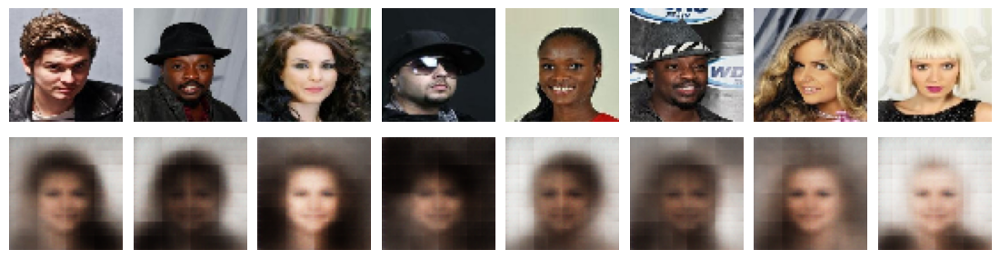

395/395 [==============================] - 75s 179ms/step - loss: 435.3347 - mean_squared_error: 0.0435 - kl_divergence: 0.1709 - fid: 8.7270
Epoch 2/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 2: 8.683961850477274

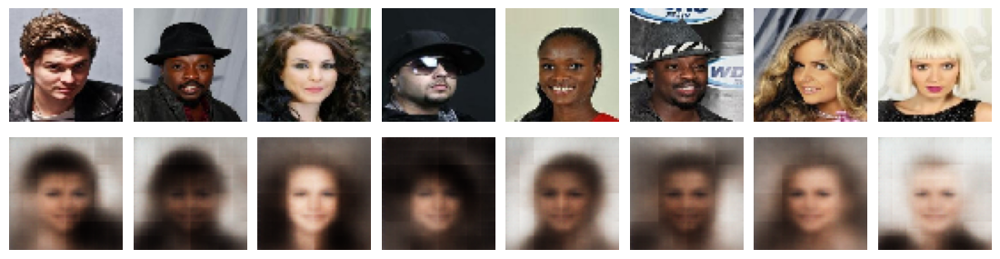

395/395 [==============================] - 67s 169ms/step - loss: 243.3171 - mean_squared_error: 0.0243 - kl_divergence: 0.1072 - fid: 8.6840
Epoch 3/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 3: 8.690385487807305

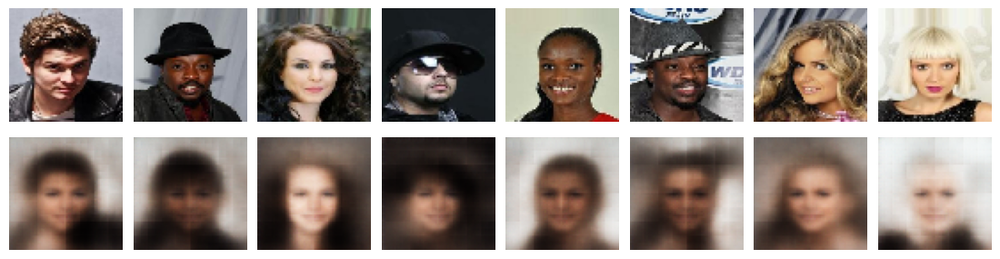

395/395 [==============================] - 66s 166ms/step - loss: 218.4034 - mean_squared_error: 0.0218 - kl_divergence: 0.0975 - fid: 8.6904
Epoch 4/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 4: 8.693740174422977

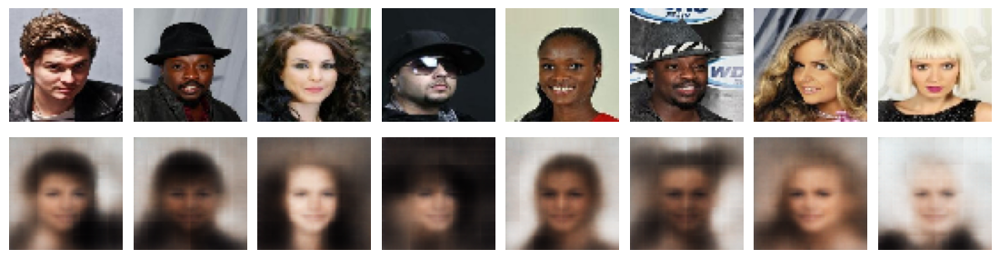

395/395 [==============================] - 64s 161ms/step - loss: 203.6567 - mean_squared_error: 0.0204 - kl_divergence: 0.0913 - fid: 8.6937
Epoch 5/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 5: 8.670684260710367

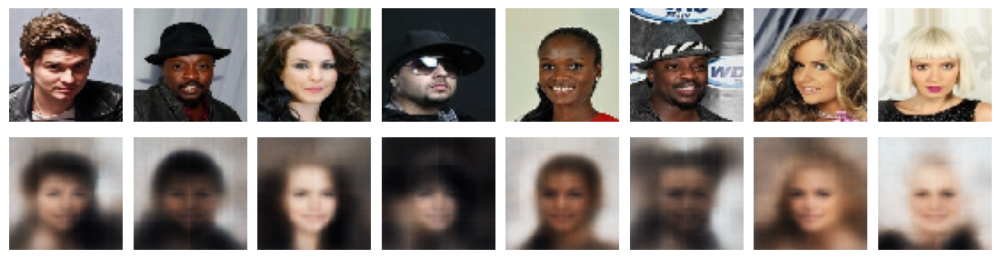

395/395 [==============================] - 65s 165ms/step - loss: 189.3044 - mean_squared_error: 0.0189 - kl_divergence: 0.0854 - fid: 8.6707
Epoch 6/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 6: 8.620193576385681

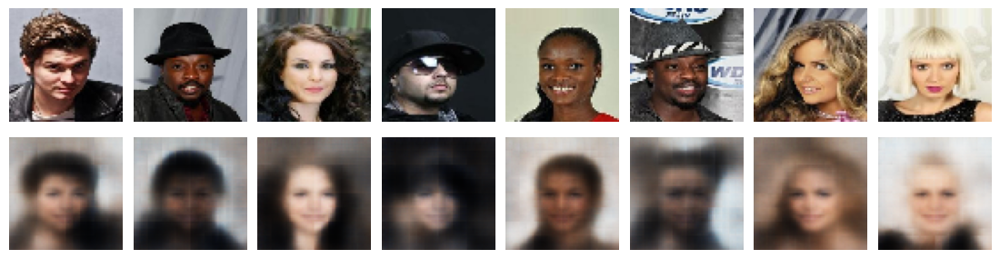

395/395 [==============================] - 67s 170ms/step - loss: 178.7569 - mean_squared_error: 0.0179 - kl_divergence: 0.0814 - fid: 8.6202
Epoch 7/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 7: 8.525093739119104

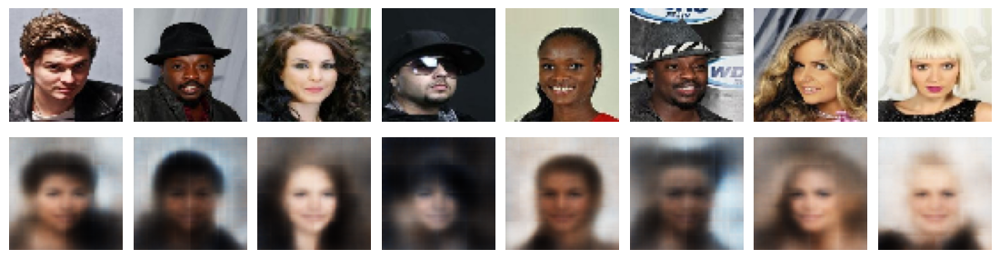

395/395 [==============================] - 68s 171ms/step - loss: 171.0291 - mean_squared_error: 0.0171 - kl_divergence: 0.0787 - fid: 8.5251
Epoch 8/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 8: 8.544831615652239

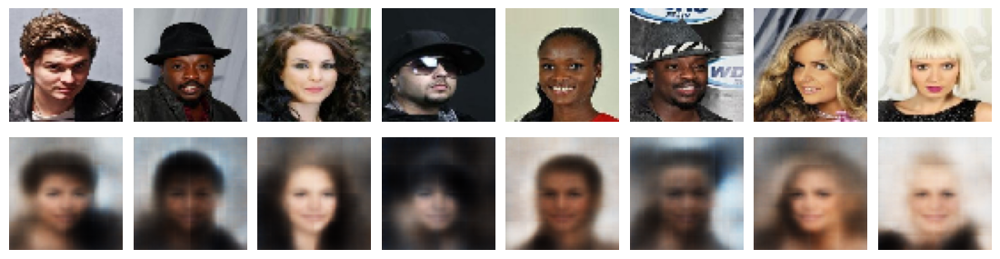

395/395 [==============================] - 67s 169ms/step - loss: 163.1384 - mean_squared_error: 0.0163 - kl_divergence: 0.0758 - fid: 8.5448
Epoch 9/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 9: 8.444454133515604

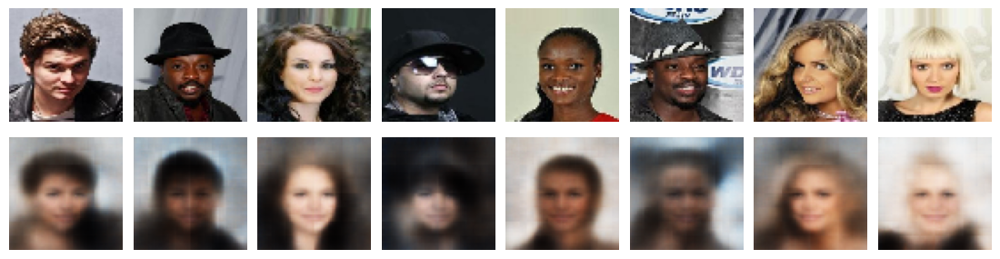

395/395 [==============================] - 67s 170ms/step - loss: 157.7770 - mean_squared_error: 0.0158 - kl_divergence: 0.0737 - fid: 8.4445
Epoch 10/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 10: 8.495471874563108

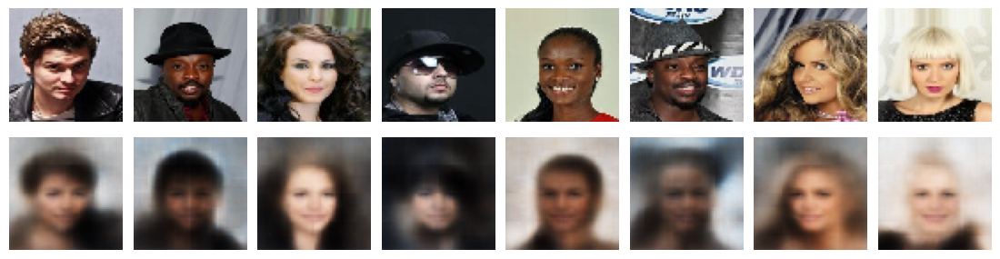

395/395 [==============================] - 68s 172ms/step - loss: 154.1115 - mean_squared_error: 0.0154 - kl_divergence: 0.0721 - fid: 8.4955
Epoch 11/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 11: 8.378554596250927

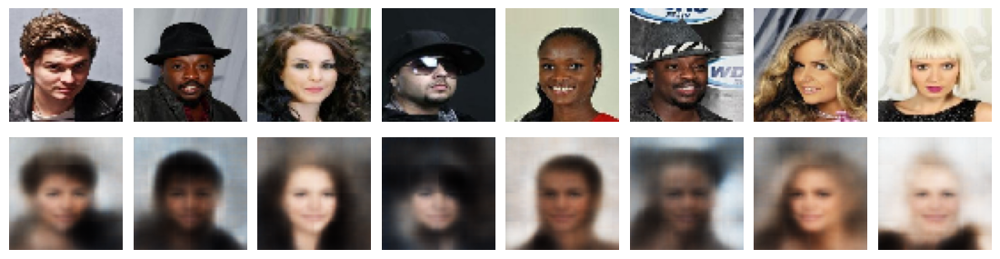

395/395 [==============================] - 66s 168ms/step - loss: 150.7534 - mean_squared_error: 0.0151 - kl_divergence: 0.0707 - fid: 8.3786
Epoch 12/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 12: 8.374630248123214

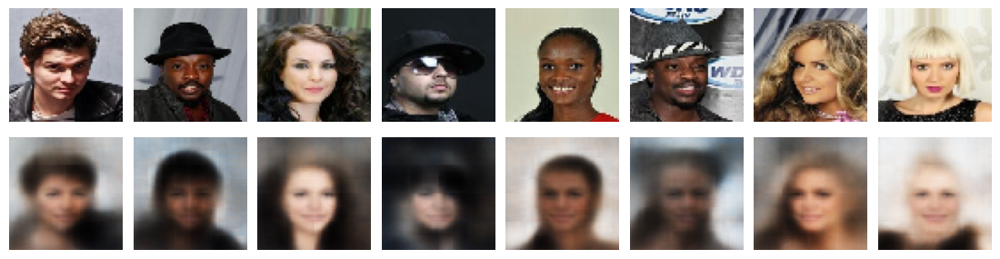

395/395 [==============================] - 67s 170ms/step - loss: 147.5374 - mean_squared_error: 0.0147 - kl_divergence: 0.0692 - fid: 8.3746
Epoch 13/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 13: 8.320707275872836

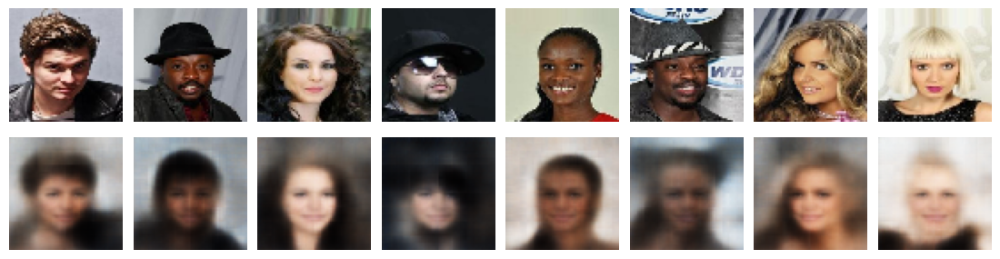

395/395 [==============================] - 69s 173ms/step - loss: 144.9590 - mean_squared_error: 0.0145 - kl_divergence: 0.0681 - fid: 8.3207
Epoch 14/20
1/1 [==============================] - 0s 22ms/step


FID at epoch 14: 8.324520521236261

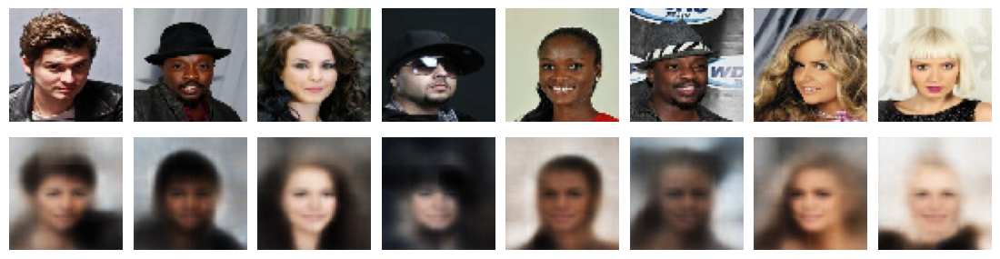

395/395 [==============================] - 67s 168ms/step - loss: 143.0581 - mean_squared_error: 0.0143 - kl_divergence: 0.0672 - fid: 8.3245
Epoch 15/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 15: 8.268538076497448

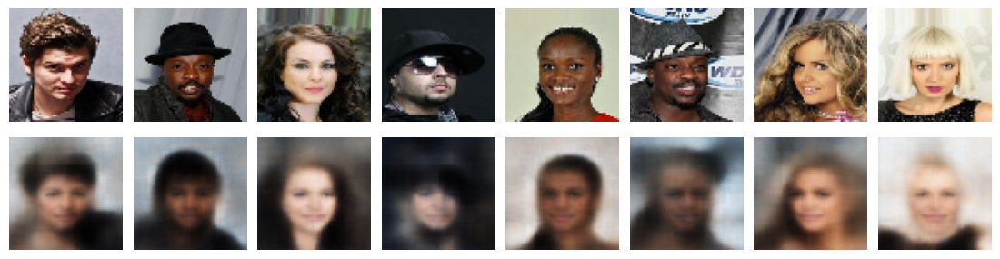

395/395 [==============================] - 68s 171ms/step - loss: 141.3367 - mean_squared_error: 0.0141 - kl_divergence: 0.0664 - fid: 8.2685
Epoch 16/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 16: 8.233161189079238

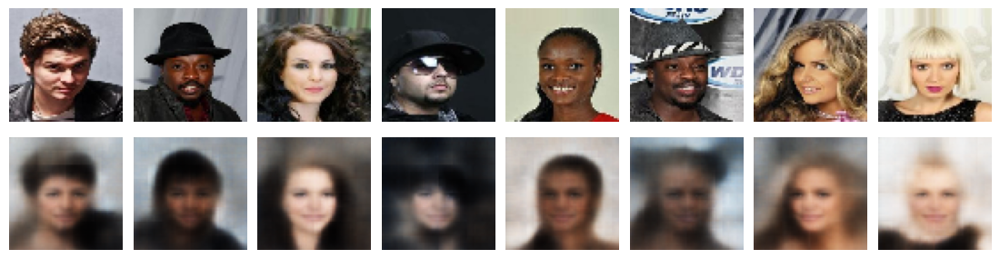

395/395 [==============================] - 67s 170ms/step - loss: 139.5412 - mean_squared_error: 0.0139 - kl_divergence: 0.0656 - fid: 8.2332
Epoch 17/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 17: 8.210950928648112

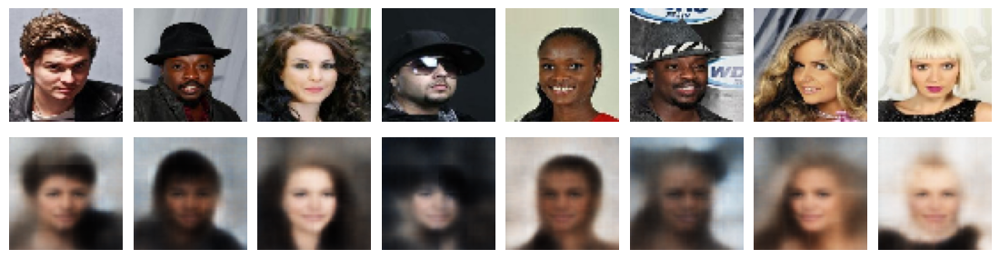

395/395 [==============================] - 72s 182ms/step - loss: 138.0095 - mean_squared_error: 0.0138 - kl_divergence: 0.0649 - fid: 8.2110
Epoch 18/20
1/1 [==============================] - 0s 22ms/step


FID at epoch 18: 8.077007358524533

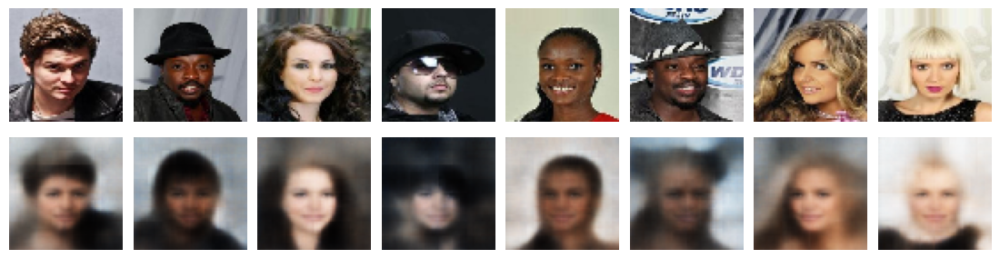

395/395 [==============================] - 69s 174ms/step - loss: 136.8569 - mean_squared_error: 0.0137 - kl_divergence: 0.0643 - fid: 8.0770
Epoch 19/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 19: 8.110571912422088

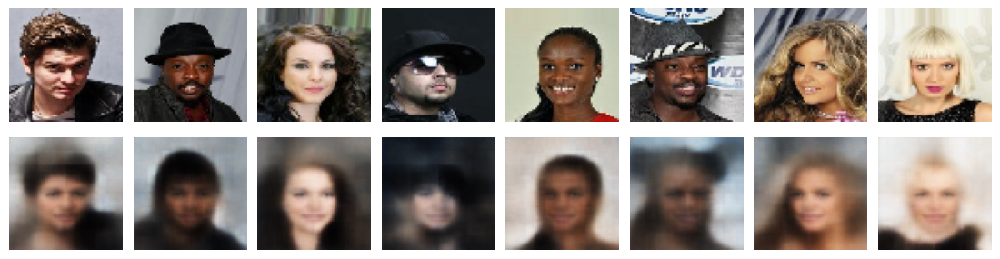

395/395 [==============================] - 71s 180ms/step - loss: 135.6646 - mean_squared_error: 0.0136 - kl_divergence: 0.0636 - fid: 8.1106
Epoch 20/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 20: 8.066099275418868

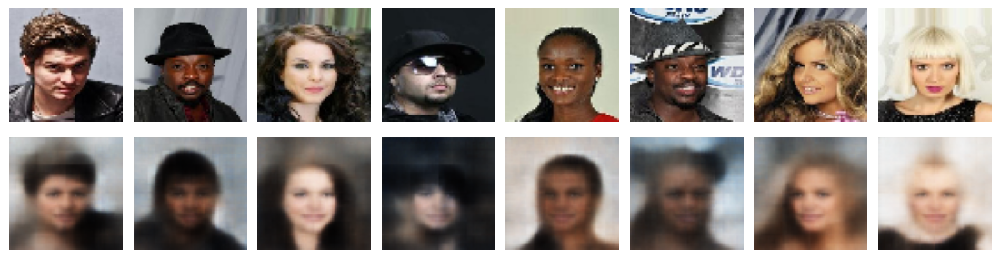

1/1 [==============================] - 0s 127ms/step


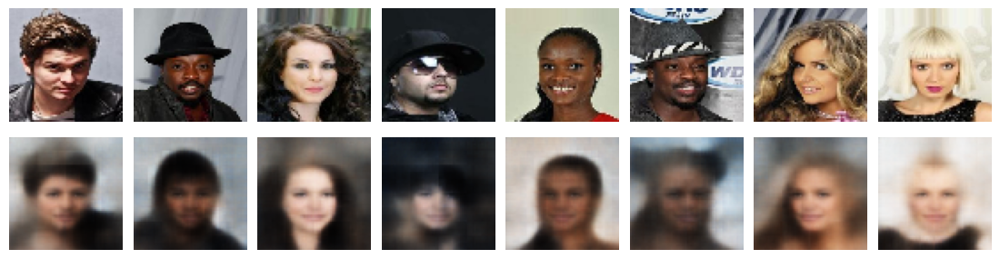

In [18]:
train_model()

### Plotting results

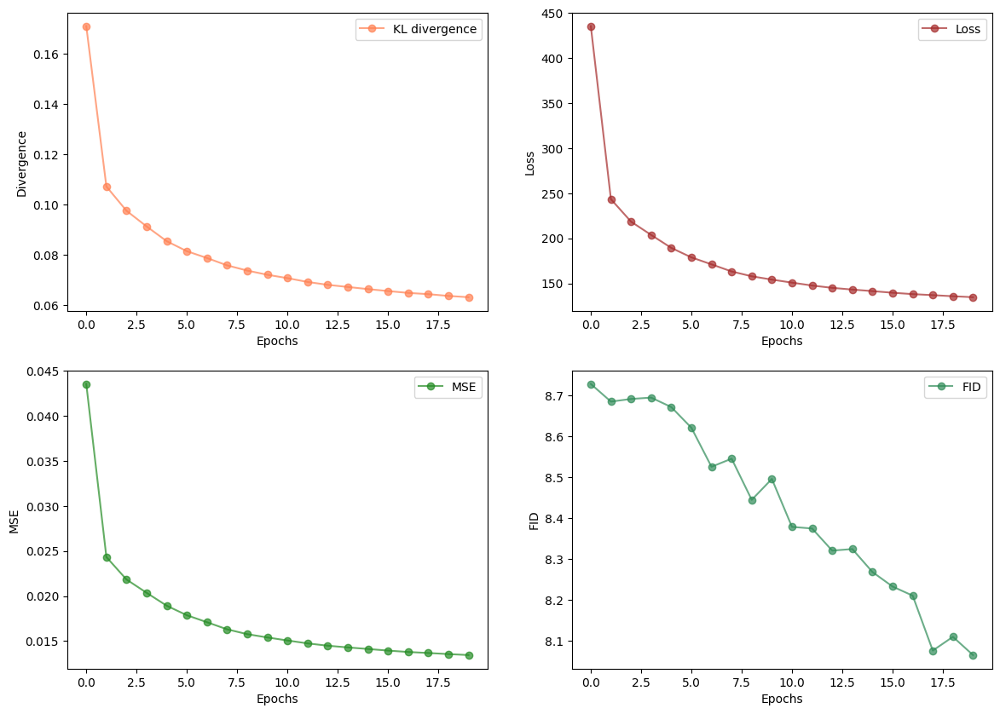

In [19]:
plot_losses_and_accuracy(loss_history)

<div style="background-color: #ffffcc; padding: 10px;">

### **Results Discussion**

In this model, the complexity of the architecture has been increased with respect to the first model. Specifically, two more layers have been added in both the encoder and the decoder. In spite of increasing the complexity, the result obtained in FID has been much worse than the one obtained by the previous model. Even so, it is a quite positive result. As in the previous model, the training is quite stable and probably to obtain better results we would need to extend the number of training epochs (perhaps in this way the initial model can be improved). As this more complex model has obtained a worse result than the initial model, in the following model we are going to reduce the complexity of the initial model.

</div>

# Other architecture II

In [20]:
## Deleting variables to avoid to crash the kernel
del vae, vae_encoder, vae_encoder_output, vae_encoder_input, vae_shape_before_flattening
del decoder_input, decoder_output, vae_decoder
del loss_history, FID_metric, plot_compare

## Build Encoder

In [21]:
vae_encoder_input, vae_encoder_output,  mean_mu, log_var, vae_shape_before_flattening, vae_encoder  = build_vae_encoder(
    input_dim = INPUT_DIM,
    output_dim = Z_DIM, 
    conv_filters = [32, 64, 64],
    #conv_filters = [16, 32, 32, 32],
    conv_kernel_size = [3,3,3],
    conv_strides = [2,2,2])

vae_encoder.summary()

plot_model(vae_encoder, show_shapes=True, show_layer_names=True)

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 encoder_input (InputLayer)  [(None, 64, 64, 3)]          0         []                            
                                                                                                  
 encoder_conv_0 (Conv2D)     (None, 32, 32, 32)           896       ['encoder_input[0][0]']       
                                                                                                  
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 32)           0         ['encoder_conv_0[0][0]']      
                                                                                                  
 encoder_conv_1 (Conv2D)     (None, 16, 16, 64)           18496     ['leaky_re_lu[0][0]']         
                                                                                              

## Build Decoder

In [22]:
decoder_input, decoder_output, vae_decoder = build_decoder(input_dim = Z_DIM,
    shape_before_flattening = vae_shape_before_flattening,
    conv_filters = [64,32,3],        
    #conv_filters = [32,32,16,3],
    conv_kernel_size = [3,3,3],
    conv_strides = [2,2,2]
    )

vae_decoder.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 decoder_input (InputLayer)  [(None, 200)]             0         
                                                                 
 dense (Dense)               (None, 4096)              823296    
                                                                 
 reshape (Reshape)           (None, 8, 8, 64)          0         
                                                                 
 decoder_conv_0 (Conv2DTran  (None, 16, 16, 64)        36928     
 spose)                                                          
                                                                 
 leaky_re_lu_3 (LeakyReLU)   (None, 16, 16, 64)        0         
                                                                 
 decoder_conv_1 (Conv2DTran  (None, 32, 32, 32)        18464     
 spose)                                                    

## Encoder + Decoder

In [23]:
vae_input = vae_encoder_input
vae_output = vae_decoder(vae_encoder_output)

# Input to the combined model will be the input to the encoder.
# Output of the combined model will be the output of the decoder.
vae = Model(vae_input, vae_output)

vae.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 encoder_input (InputLayer)  [(None, 64, 64, 3)]          0         []                            
                                                                                                  
 encoder_conv_0 (Conv2D)     (None, 32, 32, 32)           896       ['encoder_input[0][0]']       
                                                                                                  
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 32)           0         ['encoder_conv_0[0][0]']      
                                                                                                  
 encoder_conv_1 (Conv2D)     (None, 16, 16, 64)           18496     ['leaky_re_lu[0][0]']         
                                                                                            

## Compile and Train

In [24]:
import tensorflow as tf
from keras.layers import Layer
from keras.losses import mean_squared_error
#tf.config.run_functions_eagerly(True)

LEARNING_RATE = 0.0005
N_EPOCHS = 2  # No. of epochs to show advance
N_BLOCKS = 10
LOSS_FACTOR = 10000

adam_optimizer = Adam(learning_rate = LEARNING_RATE)

# Combinar las dos pérdidas
def total_losses(y_true, y_pred):
    return LOSS_FACTOR* mean_squared_error(y_true, y_pred)+tf.keras.losses.kullback_leibler_divergence(y_true, y_pred)
    
# Compile VAE model using the custom loss function
vae.compile(optimizer=adam_optimizer, loss = total_losses , metrics=[mean_squared_error, tf.keras.losses.kullback_leibler_divergence])
#vae.compile(optimizer=adam_optimizer, loss=total_loss(mean_mu, log_var), metrics=[r_loss, kl_loss])

loss_history = LossHistory()

example_batch = next(data_flow)
example_batch = example_batch[0]
example_images = example_batch[:8]
x=(NUM_IMAGES / BATCH_SIZE)
FID_metric = FIDCallback(real_images=example_images)
plot_compare= PlotCompareVAE(images=example_images)
#fid_calculator = FIDCalculator(vae_decoder, example_batch[0], Z_DIM)
#@tf.function
N_BLOCKS=1
N_EPOCHS=20
def train_model():
    for i in range(N_BLOCKS):
        vae.fit(data_flow, 
            shuffle=True, 
            epochs = N_EPOCHS, 
            initial_epoch = 0, 
            steps_per_epoch=395,
            callbacks=[FID_metric, loss_history, plot_compare])
        plot_compare_VAE(example_images) 
        


#### Simple-VAE

Epoch 1/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 1: 6.305849554017975

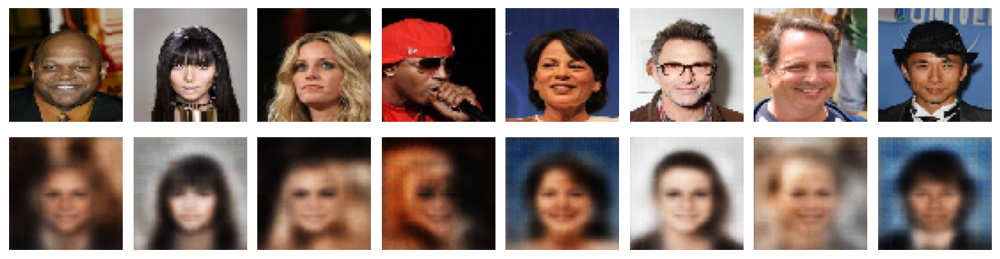

395/395 [==============================] - 75s 186ms/step - loss: 267.0730 - mean_squared_error: 0.0267 - kl_divergence: 0.1064 - fid: 6.3058
Epoch 2/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 2: 5.8399271394897045

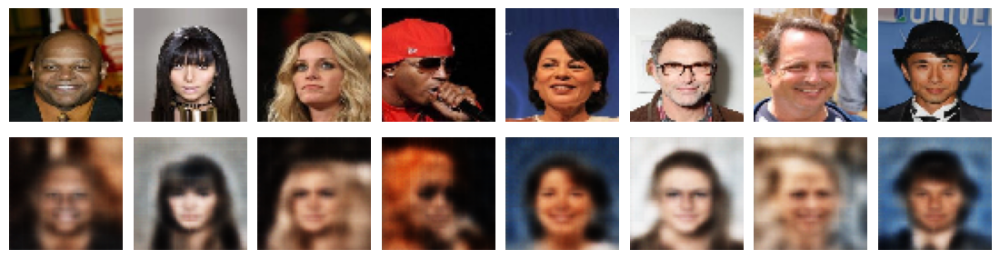

395/395 [==============================] - 71s 179ms/step - loss: 116.6894 - mean_squared_error: 0.0117 - kl_divergence: 0.0554 - fid: 5.8399
Epoch 3/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 3: 5.445918197815583

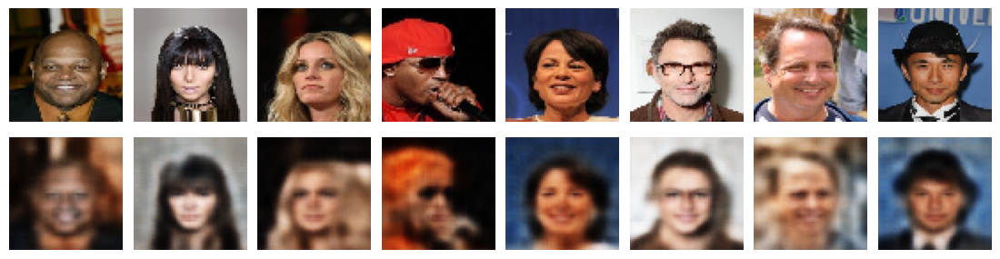

395/395 [==============================] - 76s 191ms/step - loss: 95.7684 - mean_squared_error: 0.0096 - kl_divergence: 0.0462 - fid: 5.4459
Epoch 4/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 4: 5.151959935247293

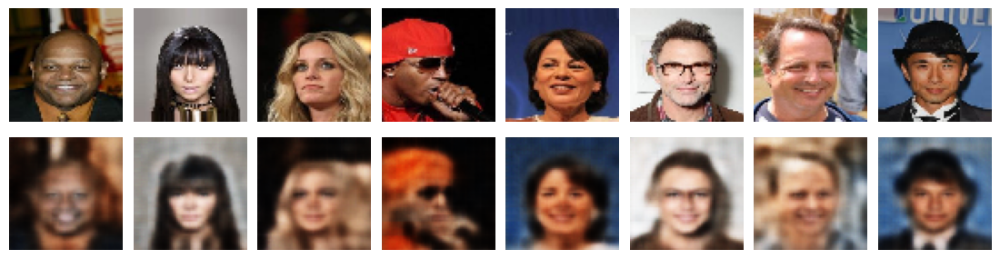

395/395 [==============================] - 70s 176ms/step - loss: 86.4417 - mean_squared_error: 0.0086 - kl_divergence: 0.0419 - fid: 5.1520
Epoch 5/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 5: 4.920607027765405

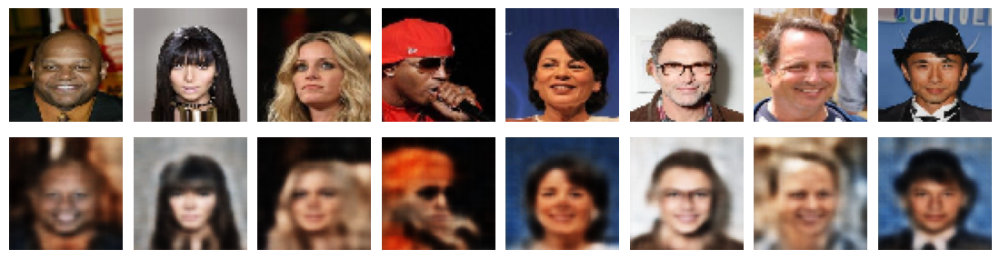

395/395 [==============================] - 69s 175ms/step - loss: 81.0960 - mean_squared_error: 0.0081 - kl_divergence: 0.0393 - fid: 4.9206
Epoch 6/20
1/1 [==============================] - 0s 22ms/step


FID at epoch 6: 4.740350781234845

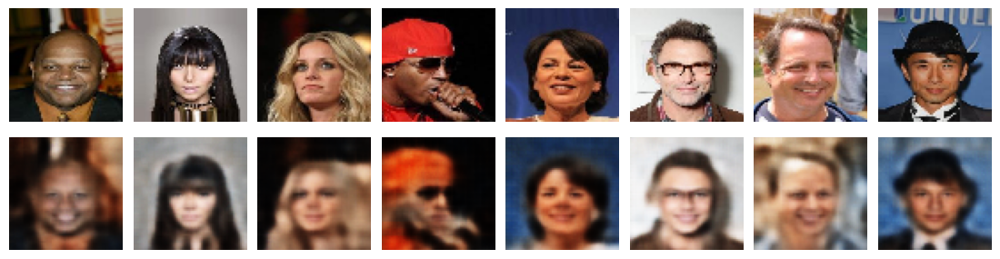

395/395 [==============================] - 71s 179ms/step - loss: 77.5275 - mean_squared_error: 0.0077 - kl_divergence: 0.0377 - fid: 4.7404
Epoch 7/20
1/1 [==============================] - 0s 22ms/step


FID at epoch 7: 4.658578906731029

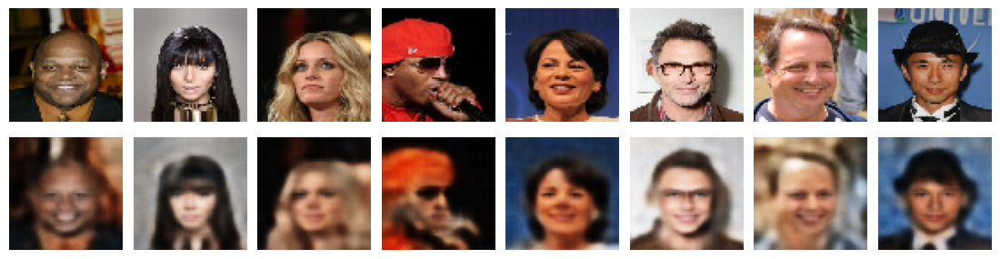

395/395 [==============================] - 67s 170ms/step - loss: 75.1119 - mean_squared_error: 0.0075 - kl_divergence: 0.0364 - fid: 4.6586
Epoch 8/20
1/1 [==============================] - 0s 22ms/step


FID at epoch 8: 4.422196907891706

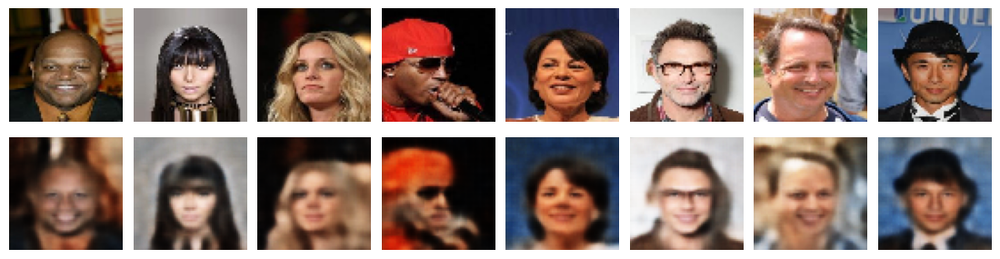

395/395 [==============================] - 69s 174ms/step - loss: 73.4220 - mean_squared_error: 0.0073 - kl_divergence: 0.0357 - fid: 4.4222
Epoch 9/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 9: 4.284941114709407

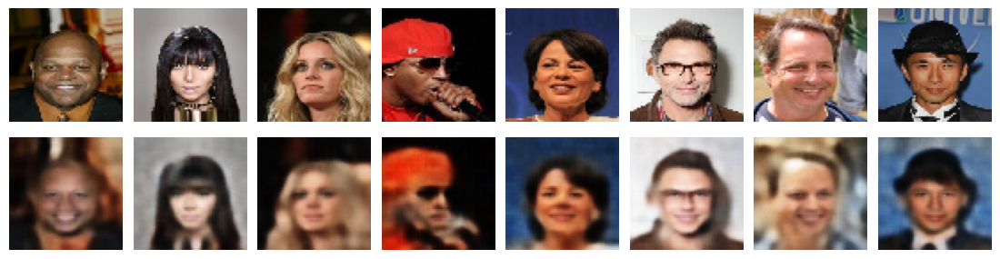

395/395 [==============================] - 69s 175ms/step - loss: 72.0025 - mean_squared_error: 0.0072 - kl_divergence: 0.0349 - fid: 4.2849
Epoch 10/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 10: 4.254520857284856

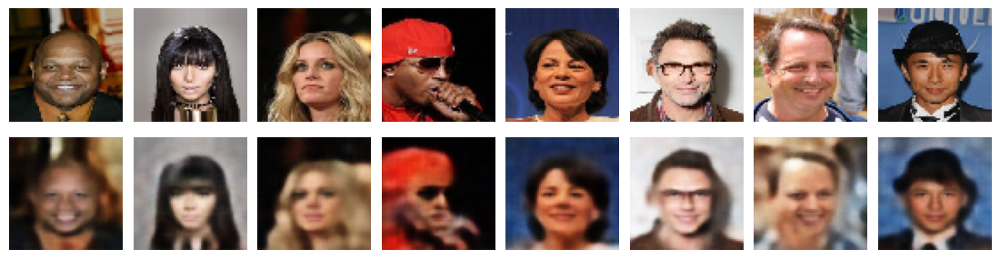

395/395 [==============================] - 70s 176ms/step - loss: 70.4874 - mean_squared_error: 0.0070 - kl_divergence: 0.0342 - fid: 4.2545
Epoch 11/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 11: 4.107013564422118

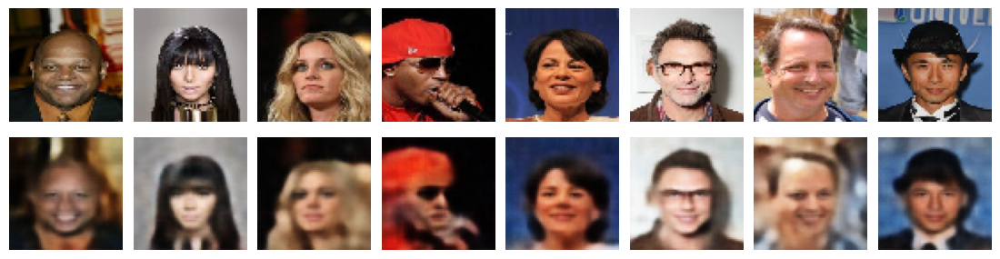

395/395 [==============================] - 69s 174ms/step - loss: 68.7924 - mean_squared_error: 0.0069 - kl_divergence: 0.0334 - fid: 4.1070
Epoch 12/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 12: 4.071395891767207

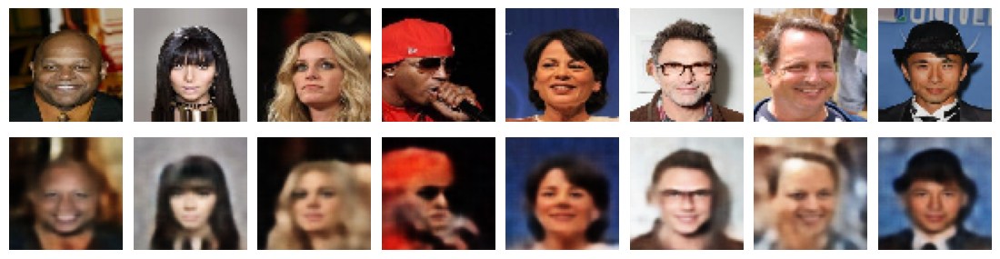

395/395 [==============================] - 69s 174ms/step - loss: 67.7929 - mean_squared_error: 0.0068 - kl_divergence: 0.0329 - fid: 4.0714
Epoch 13/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 13: 3.9884841400928708

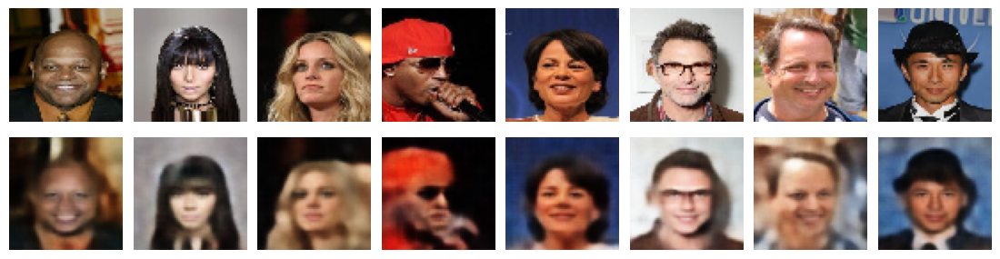

395/395 [==============================] - 69s 174ms/step - loss: 67.1018 - mean_squared_error: 0.0067 - kl_divergence: 0.0326 - fid: 3.9885
Epoch 14/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 14: 3.974789950357974

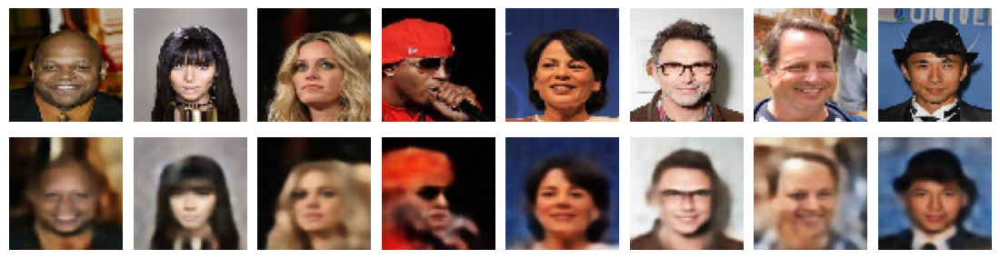

395/395 [==============================] - 70s 177ms/step - loss: 66.4395 - mean_squared_error: 0.0066 - kl_divergence: 0.0323 - fid: 3.9748
Epoch 15/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 15: 3.875499579726935

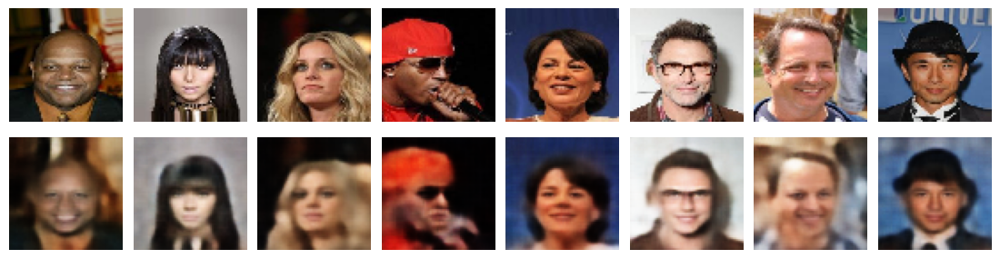

395/395 [==============================] - 69s 173ms/step - loss: 65.8687 - mean_squared_error: 0.0066 - kl_divergence: 0.0321 - fid: 3.8755
Epoch 16/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 16: 3.8342861599164406

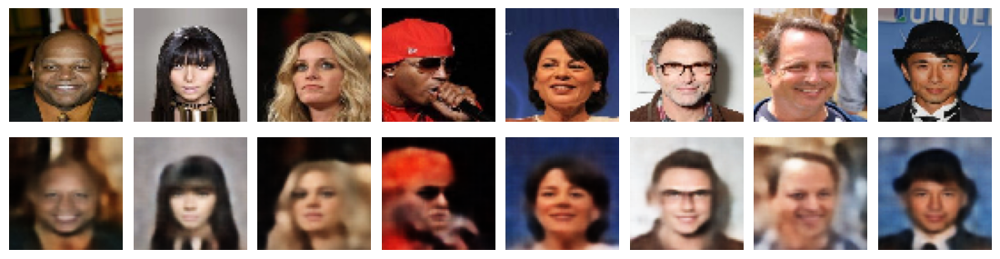

395/395 [==============================] - 74s 186ms/step - loss: 65.4511 - mean_squared_error: 0.0065 - kl_divergence: 0.0320 - fid: 3.8343
Epoch 17/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 17: 3.787137039057108

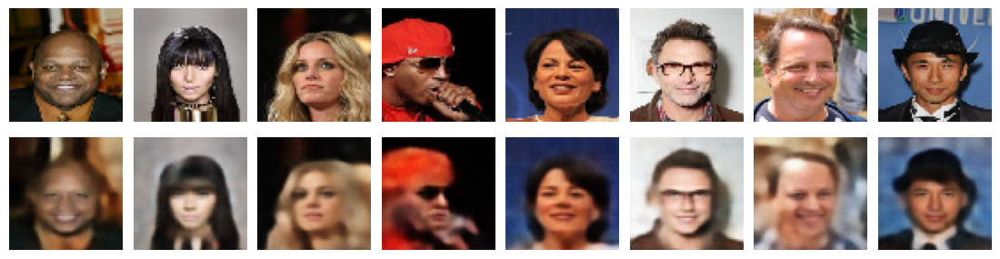

395/395 [==============================] - 71s 179ms/step - loss: 65.0417 - mean_squared_error: 0.0065 - kl_divergence: 0.0318 - fid: 3.7871
Epoch 18/20
1/1 [==============================] - 0s 20ms/step


FID at epoch 18: 3.7378821108704035

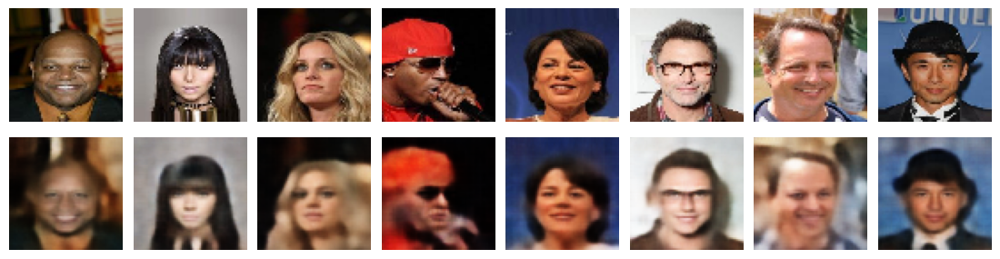

395/395 [==============================] - 70s 177ms/step - loss: 64.6217 - mean_squared_error: 0.0065 - kl_divergence: 0.0316 - fid: 3.7379
Epoch 19/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 19: 3.7258002753202613

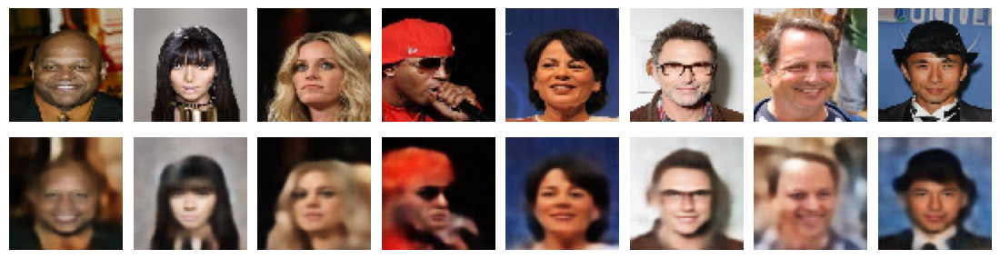

395/395 [==============================] - 67s 169ms/step - loss: 64.3113 - mean_squared_error: 0.0064 - kl_divergence: 0.0315 - fid: 3.7258
Epoch 20/20
1/1 [==============================] - 0s 21ms/step


FID at epoch 20: 3.696023807661571

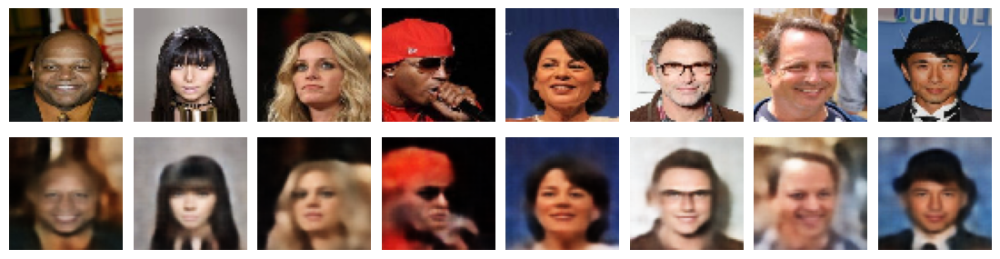

1/1 [==============================] - 0s 92ms/step


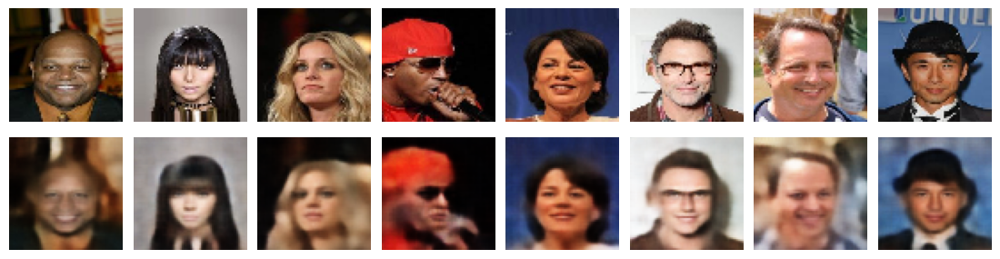

In [25]:
train_model()

In [26]:
## Saving model
vae.save('vae.keras')
vae_decoder.save('vae_decoder.keras')
vae_encoder.save('vae_encoder.keras')

### Plotting results

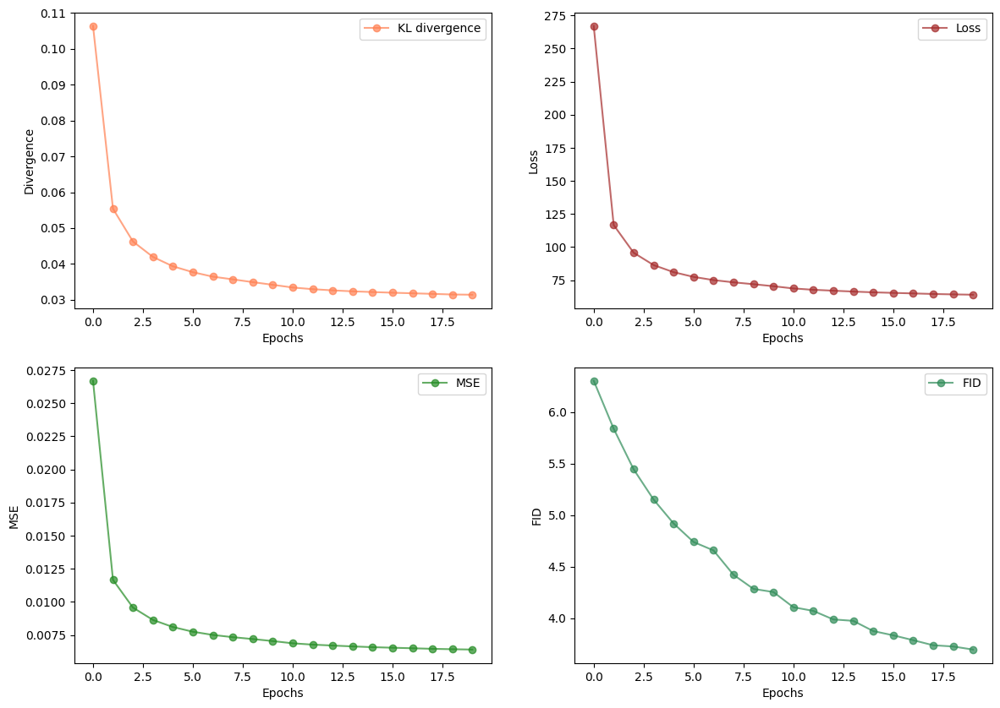

In [27]:
plot_losses_and_accuracy(loss_history)

<div style="background-color: #ffffcc; padding: 10px;">

### **Results Discussion**
In this simpler model, the layers of the initial model have been reduced creating a simpler model. As a result, the FID value obtained is quite similar to that obtained by the first model. The training is still stable, and this time it seems that with the 20 epochs the model converges and it seems that it will not improve significantly if we increase the epochs. Even so, despite having a simple architecture, the results obtained are quite favorable.


</div>

# Exploring latent space

In [28]:
#vae=load_model('vae.keras',safe_mode=False)
vae_encoder=load_model('vae_encoder.keras',safe_mode=False)
vae_decorder=load_model('vae_decoder.keras',safe_mode=False)

1/1 [==============================] - 0s 59ms/step


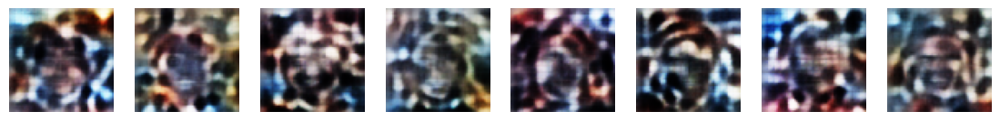

In [29]:
def VAE_generate_images_from_noise(n_to_show = 8):
    reconst_images = vae_decoder.predict(np.random.normal(0,1,size=(n_to_show, Z_DIM)))
                                                                    
    fig = plt.figure(figsize=(12, 3))
    fig.subplots_adjust(left=0.05, bottom=0.05, right=0.95, top=0.95, hspace=0.4)
    for i in range(n_to_show):
        img = reconst_images[i].squeeze()
        sub = fig.add_subplot(1, n_to_show, i+1)
        sub.axis('off')
        sub.imshow(img)
    plt.show()
VAE_generate_images_from_noise()

7/7 [==============================] - 0s 2ms/step


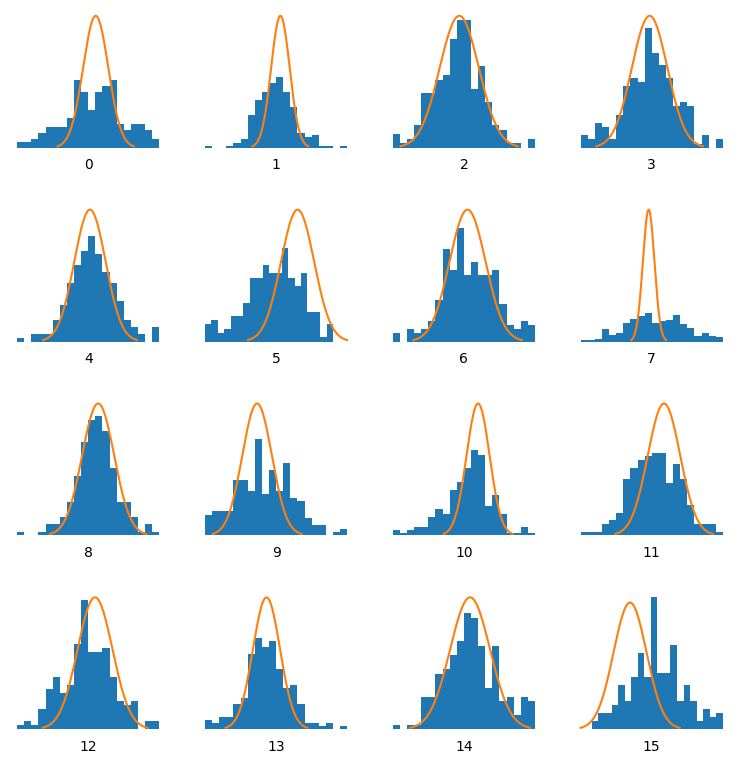

In [30]:
from scipy.stats import norm
z_test = vae_encoder.predict(example_batch[:200])
x = np.linspace(-3, 3, 300)
fig = plt.figure(figsize=(8, 8))
fig.subplots_adjust(left=0.05, bottom=0.05, right=0.95, top=0.95, hspace=0.4)
for i in range(16):
    ax = fig.add_subplot(4, 4, i+1)
    ax.hist(z_test[:,i], density=True, bins = 20)
    ax.axis('off')
    ax.text(0.5, -0.15, str(i), fontsize=10, ha='center', transform=ax.transAxes)
    ax.plot(x,norm.pdf(x))
plt.show()

1/1 [==============================] - 0s 12ms/step


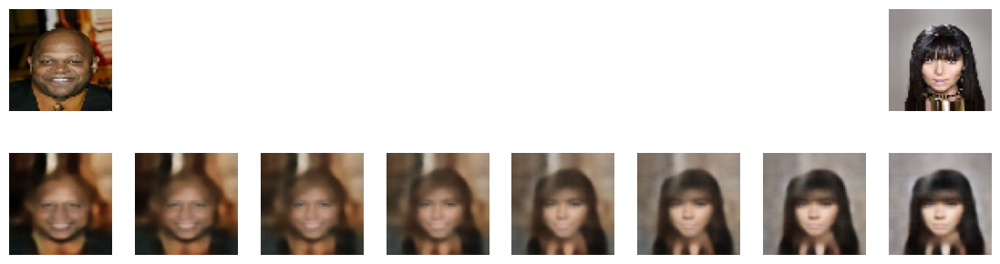

In [31]:
def VAE_linear_interpolation(images, n_to_show = 8):
    limit_images = images[0:2]
    
    fig = plt.figure(figsize=(12, 3))
    fig.subplots_adjust(left=0.05, bottom=0.05, right=0.95, top=0.95, hspace=0.4)
    
    left = limit_images[0]
    img=left.squeeze()
    sub = fig.add_subplot(2, n_to_show, 1)
    sub.axis('off')
    sub.imshow(img)
              
    right = limit_images[1]
    img=right.squeeze()
    sub = fig.add_subplot(2, n_to_show, n_to_show)
    sub.axis('off')
    sub.imshow(img)
    
    limit_encodings = vae_encoder.predict(limit_images)
    #print(limit_encodings.shape)
    interp_encodings = np.zeros((n_to_show, limit_encodings.shape[1]))
    interp_encodings[0] = limit_encodings[0]
    interp_encodings[-1] = limit_encodings[-1]
    step_size = 1 / (interp_encodings.shape[0] - 1)
    
    for i in range(1, interp_encodings.shape[0] - 1):
        interpolation_factor = i * step_size
        #interp_encodings[i] = (1 - interpolation_factor) * limit_encodings[
        interp_encodings[i] = (1 - interpolation_factor) * limit_encodings[0] + interpolation_factor * limit_encodings[1]  # Línea completada
    #print(interp_encodings.shape)
    interp_images = vae_decoder.predict(interp_encodings)
                                           
    for i in range(n_to_show):
        img = interp_images[i].squeeze()
        sub = fig.add_subplot(2, n_to_show, n_to_show+i+1)
        sub.axis('off')
        sub.imshow(img)
    plt.show()
VAE_linear_interpolation(example_images)

1/1 [==============================] - 0s 13ms/step


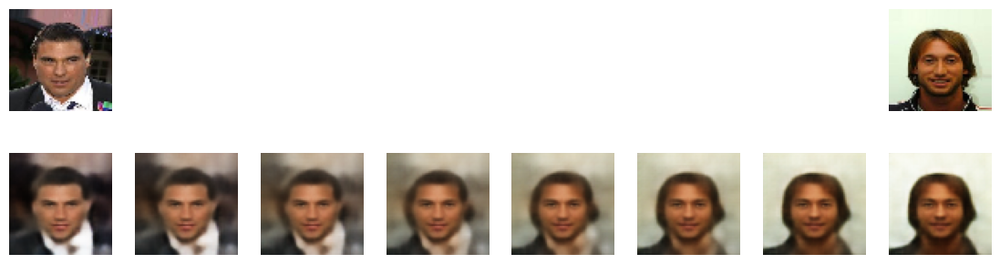

In [32]:
example_batch = next(data_flow)
example_batch = example_batch[0]
random_number1 = random.randint(0, len(example_batch))
random_number2 = random.randint(0, len(example_batch))
example_images = np.array([example_batch[random_number1], example_batch[random_number2]])
VAE_linear_interpolation(example_images)

<div style="background-color: #ffffcc; padding: 10px;">

### **Results Discussion**
Finally, to explore the latent space, in addition to the images generated with each model, an interpolation of latent vectors was performed. Random vectors were generated within the VAE's latent space and progressively interpolated to observe the effect on the images generated using the interpolated vectors. In the image above, it can be seen how the images transition smoothly from one to another, generating intermediate points that possess qualities of both extreme images.

</div>

1/1 [==============================] - 0s 13ms/step


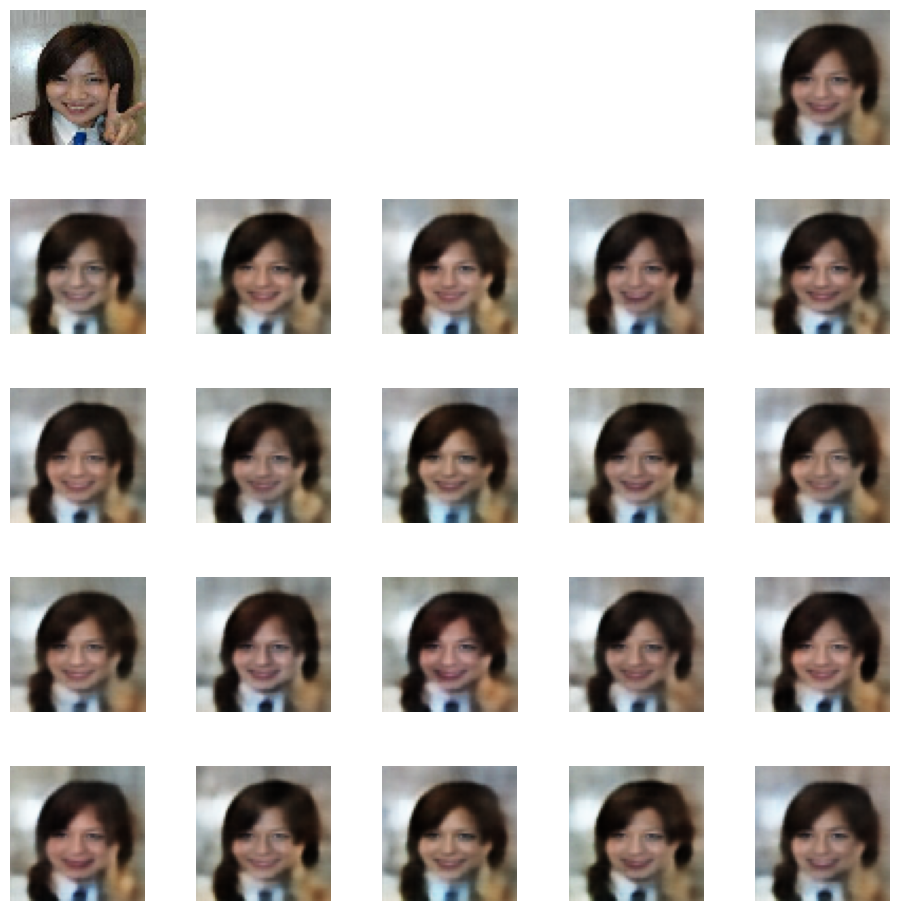

In [33]:
def VAE_distort_sample():
    example_batch = next(data_flow)
    example_batch = example_batch[0]
    input_image = example_batch[:1]
    
    fig = plt.figure(figsize=(10, 12))
    fig.subplots_adjust(left=0.05, bottom=0.05, right=0.95, top=0.95, hspace=0.4)
    img = input_image.squeeze()
    sub = fig.add_subplot(6, 5, 1)
    sub.axis('off')
    sub.imshow(img)
    
    encoded_input = vae_encoder.predict(input_image)
    output = vae_decoder.predict(encoded_input)
    img = output.squeeze()
    sub = fig.add_subplot(6, 5, 5)
    sub.axis('off')
    sub.imshow(img)
    
    for i in range(0,20):
        encoded_input2 = np.array(encoded_input)
        p = np.random.randint(0,200)
        encoded_input2[0][p] = encoded_input2[0][p] + 5
        output2 = vae_decoder.predict(encoded_input2)
        img = output2.squeeze()
        sub = fig.add_subplot(6, 5 , i+6)
        sub.axis('off')
        sub.imshow(img)
    plt.show()
    
VAE_distort_sample()